# Predicting Winners of Tennis Matches

The goal of this project is to predict the winner of individual tennis matches given specific custom features. Applications of this project may include creating a custom bracket for tournaments such as the US Open and use the model to predict the outcome of the tournament. The outline of the project is as follows:

1. EDA (Exploratory Data Analysis) and Statistics
  * Understanding the data and gain a sense of what the model baseline will be
2. Feature Engineering
  * Developing custom features about individual players preceding their matches
3. Modeling
  * Using PyCaret to compare models efficiency and choose the best estimator
  * Training a neural network to compare results to the standard models

Data source is Jeff Sackman's github repository: https://github.com/JeffSackmann/tennis_atp

In [3]:
import pandas as pd
pd.set_option('display.max_columns', None)
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense
from keras.utils.vis_utils import plot_model

import re
import jinja2
from datetime import date
from dateutil.relativedelta import relativedelta

from pycaret.classification import *
from pycaret.utils import enable_colab
enable_colab()
from pycaret.utils import check_metric

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


Colab mode enabled.


In [4]:
matches = pd.concat([pd.read_csv("/content/atp_matches_" + str(year) + ".csv") for year in range(2015, 2023)])
matches.reset_index(drop=True, inplace=True)
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,winner_name,winner_hand,winner_ht,winner_ioc,winner_age,loser_id,loser_seed,loser_entry,loser_name,loser_hand,loser_ht,loser_ioc,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points
0,2015-339,Brisbane,Hard,28,A,20150104,1,105357,NaN,WC,John Millman,R,183.0,AUS,25.500000,105733,NaN,Q,Rhyne Williams,R,NaN,USA,23.700000,6-3 6-1,3,R32,65.0,6.0,2.0,44.0,24.0,19.0,14.0,8.0,1.0,1.0,3.0,4.0,50.0,31.0,20.0,5.0,8.0,1.0,5.0,153.0,328.0,220.0,221.0
1,2015-339,Brisbane,Hard,28,A,20150104,2,103813,NaN,NaN,Jarkko Nieminen,L,185.0,FIN,33.400000,106045,NaN,Q,Denis Kudla,R,180.0,USA,22.300000,4-6 6-1 6-4,3,R32,104.0,4.0,0.0,92.0,59.0,39.0,17.0,14.0,4.0,7.0,6.0,1.0,83.0,50.0,26.0,19.0,13.0,3.0,8.0,73.0,689.0,123.0,440.0
2,2015-339,Brisbane,Hard,28,A,20150104,3,105902,NaN,WC,James Duckworth,R,183.0,AUS,22.900000,104468,6.0,NaN,Gilles Simon,R,183.0,FRA,30.000000,6-2 6-2,3,R32,68.0,4.0,0.0,45.0,27.0,20.0,11.0,8.0,2.0,3.0,2.0,1.0,56.0,37.0,22.0,5.0,8.0,10.0,15.0,125.0,430.0,21.0,1730.0
3,2015-339,Brisbane,Hard,28,A,20150104,4,104871,NaN,NaN,Jeremy Chardy,R,188.0,FRA,27.800000,104979,NaN,NaN,Andrey Golubev,R,185.0,KAZ,27.400000,6-4 6-4,3,R32,69.0,7.0,1.0,53.0,39.0,31.0,11.0,10.0,0.0,0.0,9.0,2.0,57.0,38.0,30.0,8.0,10.0,1.0,3.0,31.0,1195.0,72.0,691.0
4,2015-339,Brisbane,Hard,28,A,20150104,5,105373,NaN,NaN,Martin Klizan,L,190.0,SVK,25.400000,103781,NaN,NaN,Jurgen Melzer,L,183.0,AUT,33.600000,6-7(5) 7-6(6) 6-1,3,R32,144.0,9.0,4.0,130.0,79.0,55.0,27.0,16.0,6.0,8.0,4.0,4.0,95.0,62.0,40.0,19.0,15.0,4.0,8.0,34.0,1094.0,110.0,505.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20261,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,4,209362,NaN,NaN,Aristotelis Thanos,R,NaN,GRE,20.895277,209080,NaN,NaN,Blaise Bicknell,R,NaN,USA,20.257358,6-4 6-4,3,RR,115.0,0.0,4.0,70.0,48.0,35.0,12.0,10.0,5.0,5.0,1.0,3.0,96.0,68.0,42.0,12.0,10.0,11.0,13.0,1103.0,9.0,1130.0,8.0
20262,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,5,202065,NaN,NaN,Petros Tsitsipas,U,NaN,GRE,21.590691,202120,NaN,NaN,Rowland Phillips,R,NaN,JAM,28.098563,4-6 6-4 6-4,3,RR,161.0,7.0,2.0,94.0,55.0,37.0,23.0,15.0,9.0,12.0,1.0,1.0,94.0,56.0,40.0,20.0,15.0,4.0,8.0,808.0,23.0,1390.0,4.0
20263,2022-M-DC-2022-WG2-PO-HKG-BEN-01,Davis Cup WG2 PO: HKG vs BEN,Hard,4,D,20220304,1,138846,NaN,NaN,Hong Kit Jack Wong,R,NaN,HKG,23.498973,105278,NaN,NaN,Alexis Klegou,U,NaN,BEN,33.092402,1-6 6-4 4-1 RET,3,RR,250.0,4.0,8.0,56.0,33.0,20.0,13.0,11.0,3.0,7.0,0.0,3.0,72.0,54.0,29.0,8.0,11.0,6.0,10.0,1059.0,10.0,1881.0,1.0
20264,2022-M-DC-2022-WG2-PO-HKG-BEN-01,Davis Cup WG2 PO: HKG vs BEN,Hard,4,D,20220304,2,209409,NaN,NaN,Coleman Wong,R,NaN,HKG,17.730322,200583,NaN,NaN,Delmas Ntcha,R,NaN,BEN,21.702943,6-4 6-4,3,RR,98.0,2.0,2.0,68.0,38.0,24.0,18.0,10.0,6.0,8.0,1.0,5.0,58.0,39.0,24.0,7.0,10.0,5.0,9.0,NaN,NaN,NaN,NaN


## EDA/Statistics

In [5]:
hard_matches = matches[matches["surface"] == 'Hard']

In [6]:
clay_matches = matches[matches["surface"] == 'Clay']

In [7]:
grass_matches = matches[matches["surface"] == 'Grass']

In [8]:
len(clay_matches[(clay_matches["winner_hand"] == 'L') | (clay_matches["loser_hand"] == 'L')])

1880

In [9]:
len(grass_matches[(grass_matches["winner_hand"] == 'L') | (grass_matches["loser_hand"] == 'L')])

574

In [10]:
# lefty win percentage on hard
len(hard_matches[hard_matches['winner_hand'] == 'L']) / len(hard_matches[(hard_matches["winner_hand"] == 'L') | (hard_matches["loser_hand"] == 'L')])

0.4964813511611541

In [11]:
# lefty win percentage on clay
len(clay_matches[clay_matches['winner_hand'] == 'L']) / len(clay_matches[(clay_matches["winner_hand"] == 'L') | (clay_matches["loser_hand"] == 'L')])

0.5648936170212766

In [12]:
# lefty win percentage on grass
len(grass_matches[grass_matches['winner_hand'] == 'L']) / len(grass_matches[(grass_matches["winner_hand"] == 'L') | (grass_matches["loser_hand"] == 'L')])

0.49477351916376305

In [13]:
lefty_vs_righty = matches[((matches["winner_hand"] == 'R') & (matches["loser_hand"] == 'L')) | ((matches["winner_hand"] == 'L') & (matches["loser_hand"] == 'R'))]
lefty_vs_righty

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,winner_name,winner_hand,winner_ht,winner_ioc,winner_age,loser_id,loser_seed,loser_entry,loser_name,loser_hand,loser_ht,loser_ioc,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points
1,2015-339,Brisbane,Hard,28,A,20150104,2,103813,NaN,NaN,Jarkko Nieminen,L,185.0,FIN,33.400000,106045,NaN,Q,Denis Kudla,R,180.0,USA,22.300000,4-6 6-1 6-4,3,R32,104.0,4.0,0.0,92.0,59.0,39.0,17.0,14.0,4.0,7.0,6.0,1.0,83.0,50.0,26.0,19.0,13.0,3.0,8.0,73.0,689.0,123.0,440.0
13,2015-339,Brisbane,Hard,28,A,20150104,14,105902,NaN,WC,James Duckworth,R,183.0,AUS,22.900000,103813,NaN,NaN,Jarkko Nieminen,L,185.0,FIN,33.400000,4-6 7-6(5) 6-3,3,R16,123.0,16.0,3.0,114.0,66.0,51.0,24.0,16.0,7.0,9.0,5.0,0.0,92.0,60.0,45.0,19.0,15.0,4.0,6.0,125.0,430.0,73.0,689.0
15,2015-339,Brisbane,Hard,28,A,20150104,16,105373,NaN,NaN,Martin Klizan,L,190.0,SVK,25.400000,105238,7.0,NaN,Alexandr Dolgopolov,R,180.0,UKR,26.100000,1-6 7-6(6) 7-6(7),3,R16,147.0,4.0,5.0,116.0,73.0,46.0,18.0,15.0,5.0,10.0,16.0,2.0,103.0,68.0,51.0,19.0,16.0,1.0,4.0,34.0,1094.0,23.0,1455.0
21,2015-339,Brisbane,Hard,28,A,20150104,22,105777,4.0,NaN,Grigor Dimitrov,R,188.0,BUL,23.600000,105373,NaN,NaN,Martin Klizan,L,190.0,SVK,25.400000,6-3 6-4,3,QF,73.0,7.0,2.0,57.0,34.0,26.0,12.0,10.0,1.0,3.0,3.0,1.0,53.0,37.0,24.0,5.0,9.0,1.0,5.0,11.0,3645.0,34.0,1094.0
29,2015-891,Chennai,Hard,28,A,20150105,3,104180,8.0,NaN,Gilles Muller,L,193.0,LUX,31.600000,104273,NaN,NaN,Edouard Roger Vasselin,R,188.0,FRA,31.100000,6-7(11) 6-1 7-6(3),3,R32,143.0,29.0,4.0,100.0,65.0,49.0,23.0,15.0,3.0,4.0,4.0,3.0,101.0,69.0,50.0,16.0,16.0,1.0,5.0,46.0,855.0,116.0,470.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20227,2022-M-DC-2022-QLS-M-GER-BRA-01,Davis Cup QLS R1: GER vs BRA,Clay,4,D,20220304,2,106329,NaN,NaN,Thiago Monteiro,L,183.0,BRA,27.748118,105526,NaN,NaN,Jan Lennard Struff,R,193.0,GER,31.846680,6-3 1-6 6-3,3,RR,106.0,5.0,0.0,65.0,46.0,35.0,13.0,13.0,0.0,2.0,18.0,5.0,73.0,46.0,35.0,13.0,12.0,2.0,4.0,114.0,600.0,60.0,984.0
20228,2022-M-DC-2022-QLS-M-GER-BRA-01,Davis Cup QLS R1: GER vs BRA,Clay,4,D,20220304,4,100644,NaN,NaN,Alexander Zverev,R,198.0,GER,24.859685,106329,NaN,NaN,Thiago Monteiro,L,183.0,BRA,27.748118,6-1 7-5,3,RR,96.0,4.0,2.0,57.0,39.0,34.0,9.0,10.0,1.0,1.0,1.0,1.0,56.0,35.0,25.0,8.0,9.0,2.0,5.0,3.0,7515.0,114.0,600.0
20236,2022-M-DC-2022-QLS-M-SWE-JPN-01,Davis Cup QLS R1: SWE vs JPN,Hard,4,D,20220304,1,133297,NaN,NaN,Yosuke Watanuki,R,NaN,JPN,23.882272,200096,NaN,NaN,Dragos Nicolae Madaras,L,NaN,ROU,24.462697,6-4 6-4,3,RR,81.0,8.0,1.0,56.0,31.0,25.0,12.0,10.0,3.0,6.0,0.0,2.0,57.0,35.0,20.0,9.0,10.0,0.0,5.0,267.0,196.0,327.0,139.0
20238,2022-M-DC-2022-QLS-M-SWE-JPN-01,Davis Cup QLS R1: SWE vs JPN,Hard,4,D,20220304,4,106121,NaN,NaN,Taro Daniel,R,191.0,JPN,29.086927,200096,NaN,NaN,Dragos Nicolae Madaras,L,NaN,ROU,24.462697,6-0 7-5,3,RR,83.0,2.0,0.0,49.0,31.0,26.0,7.0,9.0,3.0,5.0,2.0,2.0,66.0,46.0,24.0,5.0,9.0,3.0,9.0,101.0,660.0,327.0,139.0


In [14]:
# lefties win percentage against righties
len((lefty_vs_righty[lefty_vs_righty['winner_hand'] == 'L'])) / len(lefty_vs_righty)

0.4791838417147568

In [15]:
lvr_hard = lefty_vs_righty[lefty_vs_righty["surface"] == 'Hard']
lvr_clay = lefty_vs_righty[lefty_vs_righty["surface"] == 'Clay']
lvr_grass = lefty_vs_righty[lefty_vs_righty["surface"] == 'Grass']

In [16]:
# lefties win percentage against righties on different surfaces
hard_lvr_pct = len(lvr_hard[lvr_hard["winner_hand"] == 'L']) / len(lvr_hard)
clay_lvr_pct = len(lvr_clay[lvr_clay["winner_hand"] == 'L']) / len(lvr_clay) 
grass_lvr_pct = len(lvr_grass[lvr_grass["winner_hand"] == 'L']) / len(lvr_grass) 

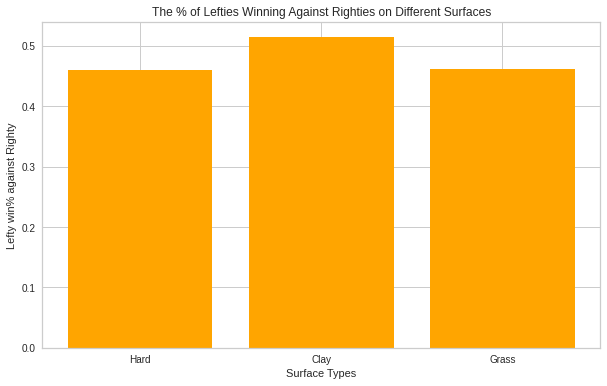

In [17]:
fig = plt.figure(figsize=(10, 6))
plt.bar(['Hard', 'Clay', 'Grass'], [hard_lvr_pct, clay_lvr_pct, grass_lvr_pct], color='orange')
plt.xlabel('Surface Types')
plt.ylabel('Lefty win% against Righty')
plt.title('The % of Lefties Winning Against Righties on Different Surfaces')
plt.show()

In [18]:
qf_g = matches[(matches["round"] == 'QF') & (matches['tourney_level'] == 'G')]
qf_g

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,winner_name,winner_hand,winner_ht,winner_ioc,winner_age,loser_id,loser_seed,loser_entry,loser_name,loser_hand,loser_ht,loser_ioc,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points
259,2015-580,Australian Open,Hard,128,G,20150119,121,104925,1.0,NaN,Novak Djokovic,R,188.0,SRB,27.600000,105683,8.0,NaN,Milos Raonic,R,196.0,CAN,24.000000,7-6(5) 6-4 6-2,5,QF,120.0,8.0,2.0,78.0,54.0,48.0,18.0,15.0,0.0,0.0,17.0,2.0,99.0,67.0,48.0,17.0,15.0,8.0,11.0,1.0,11405.0,8.0,4575.0
260,2015-580,Australian Open,Hard,128,G,20150119,122,104527,4.0,NaN,Stan Wawrinka,R,183.0,SUI,29.800000,105453,5.0,NaN,Kei Nishikori,R,178.0,JPN,25.000000,6-3 6-4 7-6(6),5,QF,124.0,21.0,4.0,91.0,56.0,48.0,19.0,16.0,3.0,4.0,6.0,2.0,94.0,58.0,43.0,18.0,15.0,8.0,11.0,4.0,5370.0,5.0,5025.0
261,2015-580,Australian Open,Hard,128,G,20150119,123,104607,7.0,NaN,Tomas Berdych,R,196.0,CZE,29.300000,104745,3.0,NaN,Rafael Nadal,L,185.0,ESP,28.600000,6-2 6-0 7-6(5),5,QF,133.0,11.0,0.0,87.0,58.0,48.0,13.0,13.0,4.0,4.0,3.0,6.0,82.0,61.0,39.0,6.0,13.0,5.0,10.0,7.0,4660.0,3.0,6585.0
262,2015-580,Australian Open,Hard,128,G,20150119,124,104918,6.0,NaN,Andy Murray,R,190.0,GBR,27.600000,106401,NaN,NaN,Nick Kyrgios,R,193.0,AUS,19.700000,6-3 7-6(5) 6-3,5,QF,125.0,12.0,1.0,87.0,60.0,48.0,18.0,16.0,1.0,2.0,9.0,3.0,110.0,69.0,45.0,21.0,14.0,6.0,9.0,6.0,4675.0,53.0,830.0
1479,2015-520,Roland Garros,Clay,128,G,20150524,121,104925,1.0,NaN,Novak Djokovic,R,188.0,SRB,28.000000,104745,6.0,NaN,Rafael Nadal,L,185.0,ESP,28.900000,7-5 6-3 6-1,5,QF,146.0,3.0,0.0,80.0,50.0,38.0,18.0,14.0,3.0,5.0,3.0,2.0,93.0,56.0,33.0,14.0,14.0,11.0,18.0,1.0,13845.0,7.0,4570.0
1480,2015-520,Roland Garros,Clay,128,G,20150524,122,104918,3.0,NaN,Andy Murray,R,190.0,GBR,28.000000,103970,7.0,NaN,David Ferrer,R,175.0,ESP,33.100000,7-6(4) 6-2 5-7 6-1,5,QF,196.0,9.0,2.0,126.0,73.0,57.0,22.0,20.0,6.0,11.0,2.0,11.0,124.0,69.0,47.0,19.0,19.0,8.0,16.0,3.0,7040.0,8.0,4490.0
1481,2015-520,Roland Garros,Clay,128,G,20150524,123,104542,14.0,NaN,Jo-Wilfried Tsonga,R,188.0,FRA,30.100000,105453,5.0,NaN,Kei Nishikori,R,178.0,JPN,25.400000,6-1 6-4 4-6 3-6 6-3,5,QF,225.0,10.0,1.0,118.0,72.0,60.0,23.0,23.0,3.0,7.0,5.0,6.0,160.0,106.0,71.0,23.0,22.0,13.0,19.0,15.0,2045.0,5.0,5220.0
1482,2015-520,Roland Garros,Clay,128,G,20150524,124,104527,8.0,NaN,Stan Wawrinka,R,183.0,SUI,30.100000,103819,2.0,NaN,Roger Federer,R,185.0,SUI,33.700000,6-4 6-3 7-6(4),5,QF,129.0,4.0,0.0,92.0,50.0,44.0,26.0,15.0,4.0,4.0,7.0,0.0,112.0,71.0,48.0,23.0,16.0,5.0,8.0,9.0,3845.0,2.0,9235.0
1769,2015-540,Wimbledon,Grass,128,G,20150629,121,104925,1.0,NaN,Novak Djokovic,R,188.0,SRB,28.100000,105227,9.0,NaN,Marin Cilic,R,198.0,CRO,26.700000,6-4 6-4 6-4,5,QF,NaN,4.0,1.0,81.0,58.0,46.0,17.0,15.0,0.0,0.0,8.0,0.0,83.0,46.0,35.0,18.0,15.0,2.0,5.0,1.0,13845.0,9.0,3540.0
1770,2015-540,Wimbledon,Grass,128,G,20150629,122,104755,21.0,NaN,Richard Gasquet,R,185.0,FRA,29.000000,104527,4.0,NaN,Stan Wawrinka,R,183.0,SUI,30.200000,6-4 4-6 3-6 6-4 11-9,5,QF,NaN,6.0,4.0,160.0,107.0,79.0,35.0,29.0,5.0,9.0,22.0,1.0,163.0,99.0,77.0,35.0,30.0,4.0,9.0,20.0,1610.0,4.0,5790.0


In [19]:
# percentage that a rank >= 30 makes it to a grand slam quarterfinals
len(qf_g[(qf_g["winner_rank"] >= 30) | (qf_g["loser_rank"] >= 30)]) / len(qf_g)

0.25862068965517243

In [20]:
g = matches[matches['tourney_level'] == 'G']
g

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,winner_name,winner_hand,winner_ht,winner_ioc,winner_age,loser_id,loser_seed,loser_entry,loser_name,loser_hand,loser_ht,loser_ioc,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points
139,2015-580,Australian Open,Hard,128,G,20150119,1,104925,1.0,NaN,Novak Djokovic,R,188.0,SRB,27.600000,105379,NaN,Q,Aljaz Bedene,R,181.0,SLO,25.500000,6-3 6-2 6-4,5,R128,109.0,8.0,3.0,79.0,52.0,44.0,17.0,14.0,3.0,3.0,12.0,3.0,89.0,53.0,35.0,17.0,13.0,4.0,8.0,1.0,11405.0,116.0,487.0
140,2015-580,Australian Open,Hard,128,G,20150119,2,105723,NaN,NaN,Andrey Kuznetsov,R,185.0,RUS,23.900000,105077,NaN,NaN,Albert Ramos,L,188.0,ESP,27.000000,6-1 3-6 6-3 7-6(3),5,R128,152.0,8.0,3.0,128.0,80.0,59.0,28.0,19.0,6.0,8.0,1.0,2.0,107.0,78.0,55.0,13.0,18.0,3.0,7.0,88.0,595.0,61.0,780.0
141,2015-580,Australian Open,Hard,128,G,20150119,3,104424,NaN,NaN,Go Soeda,R,178.0,JPN,30.300000,111200,NaN,Q,Elias Ymer,R,183.0,SWE,18.700000,1-6 6-4 4-6 6-3 6-3,5,R128,207.0,5.0,4.0,142.0,79.0,53.0,33.0,22.0,9.0,14.0,5.0,6.0,155.0,87.0,61.0,30.0,23.0,6.0,12.0,92.0,571.0,212.0,230.0
142,2015-580,Australian Open,Hard,128,G,20150119,4,104269,31.0,NaN,Fernando Verdasco,L,188.0,ESP,31.100000,104868,NaN,NaN,James Ward,R,190.0,GBR,27.900000,2-6 6-0 7-6(6) 6-3,5,R128,162.0,13.0,6.0,123.0,82.0,63.0,15.0,17.0,6.0,9.0,6.0,4.0,121.0,75.0,49.0,18.0,18.0,8.0,14.0,33.0,1135.0,103.0,539.0
143,2015-580,Australian Open,Hard,128,G,20150119,5,104545,19.0,NaN,John Isner,R,206.0,USA,29.700000,104499,NaN,Q,Jimmy Wang,R,178.0,TPE,29.900000,7-6(5) 6-4 6-4,5,R128,127.0,30.0,3.0,87.0,59.0,53.0,18.0,16.0,1.0,1.0,5.0,2.0,110.0,67.0,46.0,28.0,16.0,5.0,7.0,21.0,1685.0,118.0,485.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20029,2022-520,Roland Garros,Clay,128,G,20220523,222,134770,8,NaN,Casper Ruud,R,183.0,NOR,23.416838,208029,NaN,NaN,Holger Rune,R,NaN,DEN,19.066393,6-1 4-6 7-6(2) 6-3,5,QF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.0,3940.0,40.0,1159.0
20030,2022-520,Roland Garros,Clay,128,G,20220523,223,105227,20,NaN,Marin Cilic,R,198.0,CRO,33.648186,126094,7,NaN,Andrey Rublev,R,188.0,RUS,24.588638,5-7 6-3 6-4 3-6 7-6(2),5,QF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23.0,1695.0,7.0,3945.0
20031,2022-520,Roland Garros,Clay,128,G,20220523,224,104745,5,NaN,Rafael Nadal,L,185.0,ESP,35.969884,100644,3,NaN,Alexander Zverev,R,198.0,GER,25.089665,7-6(8) 6-6 RET,5,SF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0,5525.0,3.0,7075.0
20032,2022-520,Roland Garros,Clay,128,G,20220523,225,134770,8,NaN,Casper Ruud,R,183.0,NOR,23.416838,105227,20,NaN,Marin Cilic,R,198.0,CRO,33.648186,3-6 6-4 6-2 6-2,5,SF,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.0,3940.0,23.0,1695.0


In [21]:
# percentage of lower-rank player beating a higher-rank player in a grand slam
len(g[g["winner_rank"] > g["loser_rank"]]) / len(g)

0.2826500135758892

In [22]:
# percentage of lower-rank player beating a higher-rank player in all matches
len(matches[matches["winner_rank"] > matches["loser_rank"]]) / len(matches)

0.3447152866870621

In [23]:
mask = matches["tourney_level"].isin(["G"])
notg = matches[~mask]
notg

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,winner_name,winner_hand,winner_ht,winner_ioc,winner_age,loser_id,loser_seed,loser_entry,loser_name,loser_hand,loser_ht,loser_ioc,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points
0,2015-339,Brisbane,Hard,28,A,20150104,1,105357,NaN,WC,John Millman,R,183.0,AUS,25.500000,105733,NaN,Q,Rhyne Williams,R,NaN,USA,23.700000,6-3 6-1,3,R32,65.0,6.0,2.0,44.0,24.0,19.0,14.0,8.0,1.0,1.0,3.0,4.0,50.0,31.0,20.0,5.0,8.0,1.0,5.0,153.0,328.0,220.0,221.0
1,2015-339,Brisbane,Hard,28,A,20150104,2,103813,NaN,NaN,Jarkko Nieminen,L,185.0,FIN,33.400000,106045,NaN,Q,Denis Kudla,R,180.0,USA,22.300000,4-6 6-1 6-4,3,R32,104.0,4.0,0.0,92.0,59.0,39.0,17.0,14.0,4.0,7.0,6.0,1.0,83.0,50.0,26.0,19.0,13.0,3.0,8.0,73.0,689.0,123.0,440.0
2,2015-339,Brisbane,Hard,28,A,20150104,3,105902,NaN,WC,James Duckworth,R,183.0,AUS,22.900000,104468,6.0,NaN,Gilles Simon,R,183.0,FRA,30.000000,6-2 6-2,3,R32,68.0,4.0,0.0,45.0,27.0,20.0,11.0,8.0,2.0,3.0,2.0,1.0,56.0,37.0,22.0,5.0,8.0,10.0,15.0,125.0,430.0,21.0,1730.0
3,2015-339,Brisbane,Hard,28,A,20150104,4,104871,NaN,NaN,Jeremy Chardy,R,188.0,FRA,27.800000,104979,NaN,NaN,Andrey Golubev,R,185.0,KAZ,27.400000,6-4 6-4,3,R32,69.0,7.0,1.0,53.0,39.0,31.0,11.0,10.0,0.0,0.0,9.0,2.0,57.0,38.0,30.0,8.0,10.0,1.0,3.0,31.0,1195.0,72.0,691.0
4,2015-339,Brisbane,Hard,28,A,20150104,5,105373,NaN,NaN,Martin Klizan,L,190.0,SVK,25.400000,103781,NaN,NaN,Jurgen Melzer,L,183.0,AUT,33.600000,6-7(5) 7-6(6) 6-1,3,R32,144.0,9.0,4.0,130.0,79.0,55.0,27.0,16.0,6.0,8.0,4.0,4.0,95.0,62.0,40.0,19.0,15.0,4.0,8.0,34.0,1094.0,110.0,505.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20261,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,4,209362,NaN,NaN,Aristotelis Thanos,R,NaN,GRE,20.895277,209080,NaN,NaN,Blaise Bicknell,R,NaN,USA,20.257358,6-4 6-4,3,RR,115.0,0.0,4.0,70.0,48.0,35.0,12.0,10.0,5.0,5.0,1.0,3.0,96.0,68.0,42.0,12.0,10.0,11.0,13.0,1103.0,9.0,1130.0,8.0
20262,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,5,202065,NaN,NaN,Petros Tsitsipas,U,NaN,GRE,21.590691,202120,NaN,NaN,Rowland Phillips,R,NaN,JAM,28.098563,4-6 6-4 6-4,3,RR,161.0,7.0,2.0,94.0,55.0,37.0,23.0,15.0,9.0,12.0,1.0,1.0,94.0,56.0,40.0,20.0,15.0,4.0,8.0,808.0,23.0,1390.0,4.0
20263,2022-M-DC-2022-WG2-PO-HKG-BEN-01,Davis Cup WG2 PO: HKG vs BEN,Hard,4,D,20220304,1,138846,NaN,NaN,Hong Kit Jack Wong,R,NaN,HKG,23.498973,105278,NaN,NaN,Alexis Klegou,U,NaN,BEN,33.092402,1-6 6-4 4-1 RET,3,RR,250.0,4.0,8.0,56.0,33.0,20.0,13.0,11.0,3.0,7.0,0.0,3.0,72.0,54.0,29.0,8.0,11.0,6.0,10.0,1059.0,10.0,1881.0,1.0
20264,2022-M-DC-2022-WG2-PO-HKG-BEN-01,Davis Cup WG2 PO: HKG vs BEN,Hard,4,D,20220304,2,209409,NaN,NaN,Coleman Wong,R,NaN,HKG,17.730322,200583,NaN,NaN,Delmas Ntcha,R,NaN,BEN,21.702943,6-4 6-4,3,RR,98.0,2.0,2.0,68.0,38.0,24.0,18.0,10.0,6.0,8.0,1.0,5.0,58.0,39.0,24.0,7.0,10.0,5.0,9.0,NaN,NaN,NaN,NaN


In [24]:
# percentage that lower-ranked players beat higher-ranked players in all tournaments excluding grand slams
len(notg[notg["winner_rank"] > notg["loser_rank"]]) / len(notg)

0.35849966833504193

In [25]:
upsets = matches[matches["winner_rank"] > matches["loser_rank"]]
upsets

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,winner_name,winner_hand,winner_ht,winner_ioc,winner_age,loser_id,loser_seed,loser_entry,loser_name,loser_hand,loser_ht,loser_ioc,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points
2,2015-339,Brisbane,Hard,28,A,20150104,3,105902,NaN,WC,James Duckworth,R,183.0,AUS,22.900000,104468,6.0,NaN,Gilles Simon,R,183.0,FRA,30.000000,6-2 6-2,3,R32,68.0,4.0,0.0,45.0,27.0,20.0,11.0,8.0,2.0,3.0,2.0,1.0,56.0,37.0,22.0,5.0,8.0,10.0,15.0,125.0,430.0,21.0,1730.0
6,2015-339,Brisbane,Hard,28,A,20150104,7,103997,NaN,Q,Lukasz Kubot,R,190.0,POL,32.600000,104731,5.0,NaN,Kevin Anderson,R,203.0,RSA,28.600000,7-6(3) 6-4,3,R32,110.0,6.0,5.0,78.0,51.0,35.0,14.0,11.0,3.0,5.0,12.0,3.0,76.0,43.0,30.0,17.0,11.0,4.0,7.0,177.0,282.0,16.0,2080.0
7,2015-339,Brisbane,Hard,28,A,20150104,8,105032,NaN,NaN,Sam Groth,R,193.0,AUS,27.200000,103720,NaN,NaN,Lleyton Hewitt,R,180.0,AUS,33.800000,6-3 6-2,3,R32,59.0,14.0,0.0,47.0,34.0,30.0,8.0,9.0,2.0,2.0,1.0,2.0,45.0,22.0,13.0,14.0,8.0,1.0,4.0,85.0,586.0,84.0,595.0
9,2015-339,Brisbane,Hard,28,A,20150104,10,106423,NaN,WC,Thanasi Kokkinakis,R,196.0,AUS,18.700000,103898,8.0,NaN,Julien Benneteau,R,185.0,FRA,33.000000,6-4 6-3,3,R32,75.0,9.0,1.0,52.0,30.0,25.0,14.0,10.0,1.0,2.0,5.0,3.0,52.0,33.0,23.0,7.0,9.0,1.0,4.0,149.0,341.0,25.0,1365.0
10,2015-339,Brisbane,Hard,28,A,20150104,11,106071,NaN,NaN,Bernard Tomic,R,193.0,AUS,22.200000,105023,NaN,NaN,Sam Querrey,R,198.0,USA,27.200000,7-5 7-6(5),3,R32,83.0,5.0,0.0,77.0,46.0,36.0,21.0,12.0,4.0,5.0,20.0,3.0,70.0,42.0,35.0,14.0,12.0,4.0,6.0,53.0,797.0,35.0,1090.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20237,2022-M-DC-2022-QLS-M-SWE-JPN-01,Davis Cup QLS R1: SWE vs JPN,Hard,4,D,20220304,2,111200,NaN,NaN,Elias Ymer,R,183.0,SWE,25.886379,106121,NaN,NaN,Taro Daniel,R,191.0,JPN,29.086927,7-5 6-4,3,RR,117.0,7.0,5.0,89.0,50.0,38.0,20.0,11.0,9.0,10.0,2.0,0.0,64.0,37.0,26.0,14.0,11.0,5.0,8.0,133.0,496.0,101.0,660.0
20246,2022-M-DC-2022-WG1-PO-IND-DEN-01,Davis Cup WG1 PO: IND vs DEN,Grass,4,D,20220304,2,106026,NaN,NaN,Yuki Bhambri,R,183.0,IND,29.653662,111453,NaN,NaN,Mikael Torpegaard,R,NaN,DEN,27.811088,6-4 6-4,3,RR,87.0,3.0,2.0,59.0,26.0,17.0,20.0,10.0,4.0,6.0,6.0,7.0,72.0,44.0,31.0,10.0,10.0,5.0,9.0,590.0,48.0,305.0,157.0
20251,2022-M-DC-2022-WG1-PO-UZB-TUR-01,Davis Cup WG1 PO: UZB vs TUR,Hard,4,D,20220304,1,122109,NaN,NaN,Sanjar Fayziev,U,NaN,UZB,27.586585,117356,NaN,NaN,Cem Ilkel,R,185.0,TUR,26.524298,6-3 6-7(1) 6-4,3,RR,157.0,11.0,0.0,105.0,56.0,40.0,25.0,16.0,4.0,6.0,7.0,5.0,99.0,60.0,42.0,19.0,15.0,3.0,8.0,510.0,62.0,189.0,314.0
20259,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,1,202120,NaN,NaN,Rowland Phillips,R,NaN,JAM,28.098563,133018,NaN,NaN,Michail Pervolarakis,R,NaN,CYP,25.730322,6-2 4-6 6-3,3,RR,130.0,3.0,3.0,84.0,49.0,36.0,19.0,14.0,3.0,5.0,2.0,2.0,77.0,41.0,22.0,20.0,13.0,4.0,8.0,1390.0,4.0,402.0,98.0


In [26]:
hard_upsets = upsets[upsets["surface"] == 'Hard']
clay_upsets = upsets[upsets["surface"] == 'Clay']
grass_upsets = upsets[upsets["surface"] == 'Grass']

In [27]:
# Percentage of upset on hard court
hard_upset_pct = len(hard_upsets) / len(hard_matches)
hard_upset_pct

0.3391951301995266

In [28]:
# Percentage of upset on clay court
clay_upset_pct = len(clay_upsets) / len(clay_matches)
clay_upset_pct

0.3516989520482693

In [29]:
# Percentage of upset on grass court
grass_upset_pct = len(grass_upsets) / len(grass_matches)
grass_upset_pct

0.3554926921263555

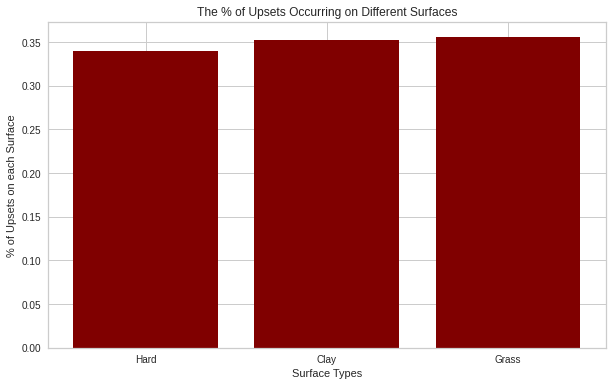

In [30]:
fig = plt.figure(figsize=(10, 6))
plt.bar(['Hard', 'Clay', 'Grass'], [hard_upset_pct, clay_upset_pct, grass_upset_pct], color='maroon')
plt.xlabel('Surface Types')
plt.ylabel('% of Upsets on each Surface')
plt.title('The % of Upsets Occurring on Different Surfaces')
plt.show()

In [31]:
matches['tourney_level'].value_counts()

A    11040
M     3866
G     3683
D     1525
F      152
Name: tourney_level, dtype: int64

In [32]:
A_upsets = len(upsets[upsets['tourney_level'] == 'A']) / len(matches[matches['tourney_level'] == 'A'])
M_upsets = len(upsets[upsets['tourney_level'] == 'M']) / len(matches[matches['tourney_level'] == 'M'])
G_upsets = len(upsets[upsets['tourney_level'] == 'G']) / len(matches[matches['tourney_level'] == 'G'])
D_upsets = len(upsets[upsets['tourney_level'] == 'D']) / len(matches[matches['tourney_level'] == 'D'])
F_upsets = len(upsets[upsets['tourney_level'] == 'F']) / len(matches[matches['tourney_level'] == 'F'])

In [33]:
G_upsets

0.2826500135758892

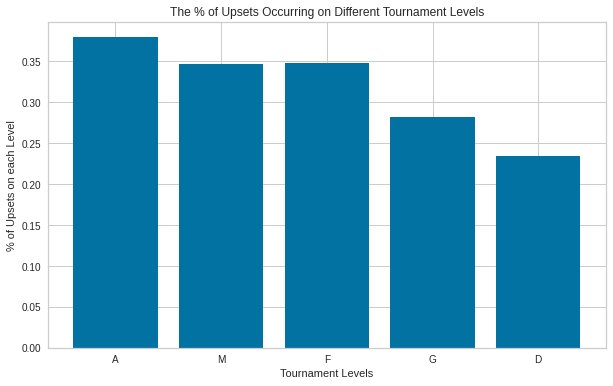

In [34]:
fig = plt.figure(figsize=(10, 6))
plt.bar(['A', 'M', 'F', 'G', 'D'], [A_upsets, M_upsets, F_upsets, G_upsets, D_upsets])
plt.xlabel('Tournament Levels')
plt.ylabel('% of Upsets on each Level')
plt.title('The % of Upsets Occurring on Different Tournament Levels')
plt.show()

***Notes***

**Correlations/Statistics**
* rank vs rankpoints (negative correlation)
* height vs aces (positive correlation)
* lefties do not have the advantage stastically (~48% win rate against righties)
* lefties have do better against righties on clay courts (~51% vs ~46%)
* ~26% chance a low-ranked player (>=30) who plays in a grand slam makes it to the QF round
* ~player who has higher 1st serve win percentage wins the match ~80% of the time

**Upset Analysis**
* what is margin that most of these upsets occur in (maybe 50 ranks?)
* as the player's rank increases, this margin also increases
  * the rank 1 losing to the 25 sounds worse than the 100 losing to the 200
* however, most of these "upsets" are like the latter
  * this means the idea of an **upset** is altered to where a very high ranked player (1-10) loses to a lower-ranked player
* if this idea of an upset is expected to happen about 1 out of 4 times in a grand slam tournament, then what is considered an upset should take other factors in (other than ranking) such as if the higher-ranked player is in a slum, if a previously high-ranked player recently recovered from an injury and his ranking dropped (this situation should not be put in the same group as the upsets)
* in all tournaments, the raw upset percentage (lower-rank beating a higher-rank) is ~34%
* in all tournaments **excluding grand slam tournaments**, the raw upset percentage is ~36%
* in the grand slam tournaments, the raw upset percentage is ~28%
* it is less likely for an upset to happen in a grand slam than other tournaments
* percentage of an upset occurring on each surface type:
  * hard: ~34%
  * clay: ~35%
  * grass: ~36%
* percentage of an upset occurring at each tourney level:
  * ATP Tour: ~38%
  * ATP Masters: ~35%
  * ATP Finals: ~35%
  * Grand Slam: ~28%
  * Davis Cup: ~23$
* as tournament tier improves, upset % decreases

## Feature Engineering

### Getting Features Ready

In [35]:
matches.rename(columns={'w_ace': 'winner_ace',
                        'w_df': 'winner_df',
                        'w_svpt': 'winner_svpt',
                        'w_1stIn': 'winner_1stIn',
                        'w_1stWon': 'winner_1stWon',
                        'w_2ndWon': 'winner_2ndWon',
                        'w_SvGms': 'winner_SvGms',
                        'w_bpSaved': 'winner_bpSaved',
                        'w_bpFaced': 'winner_bpFaced'},
                        inplace=True)

In [36]:
matches.rename(columns={'l_ace': 'loser_ace',
                        'l_df': 'loser_df',
                        'l_svpt': 'loser_svpt',
                        'l_1stIn': 'loser_1stIn',
                        'l_1stWon': 'loser_1stWon',
                        'l_2ndWon': 'loser_2ndWon',
                        'l_SvGms': 'loser_SvGms',
                        'l_bpSaved': 'loser_bpSaved',
                        'l_bpFaced': 'loser_bpFaced'},
                        inplace=True)

In [37]:
WL_extensions = ['age', 'entry', 'hand', 'ht', 'ioc', 'rank', 'rank_points', 'seed', 'ace', 'df', 'svpt', '1stIn', '1stWon', '2ndWon', 'SvGms', 'bpSaved', 'bpFaced']

def obscure_features(DF):

    DF['player_1'] = pd.concat([DF['winner_name'], DF['loser_name']], axis = 1).min(axis = 1)
    DF['player_2'] = pd.concat([DF['winner_name'], DF['loser_name']], axis = 1).max(axis = 1)
    
    for ext in WL_extensions:
        p1_feature = np.where(DF['player_1'] == DF['winner_name'],
                     DF['winner_' + ext],
                     DF['loser_' + ext])
    
        p2_feature = np.where(DF['player_2'] == DF['winner_name'],
                     DF['winner_' + ext],
                     DF['loser_' + ext])
    
        DF['player_1_' + ext] = p1_feature
        DF['player_2_' + ext] = p2_feature
        
    winner_cols = list(filter(lambda x: x.startswith('winner'), DF.columns))
    loser_cols = list(filter(lambda x: x.startswith('loser'), DF.columns))
    cols_to_drop = winner_cols + loser_cols
    
    target = DF['winner_name']
    
    DF.drop(cols_to_drop, axis = 1, inplace = True)
    
    DF['winner'] = target
    
    return DF

matches = obscure_features(matches)

In [38]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner
0,2015-339,Brisbane,Hard,28,A,20150104,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman
1,2015-339,Brisbane,Hard,28,A,20150104,2,4-6 6-1 6-4,3,R32,104.0,Denis Kudla,Jarkko Nieminen,22.300000,33.400000,Q,NaN,R,L,180.0,185.0,USA,FIN,123.0,73.0,440.0,689.0,NaN,NaN,6.0,4.0,1.0,0.0,83.0,92.0,50.0,59.0,26.0,39.0,19.0,17.0,13.0,14.0,3.0,4.0,8.0,7.0,Jarkko Nieminen
2,2015-339,Brisbane,Hard,28,A,20150104,3,6-2 6-2,3,R32,68.0,Gilles Simon,James Duckworth,30.000000,22.900000,NaN,WC,R,R,183.0,183.0,FRA,AUS,21.0,125.0,1730.0,430.0,6.0,NaN,2.0,4.0,1.0,0.0,56.0,45.0,37.0,27.0,22.0,20.0,5.0,11.0,8.0,8.0,10.0,2.0,15.0,3.0,James Duckworth
3,2015-339,Brisbane,Hard,28,A,20150104,4,6-4 6-4,3,R32,69.0,Andrey Golubev,Jeremy Chardy,27.400000,27.800000,NaN,NaN,R,R,185.0,188.0,KAZ,FRA,72.0,31.0,691.0,1195.0,NaN,NaN,9.0,7.0,2.0,1.0,57.0,53.0,38.0,39.0,30.0,31.0,8.0,11.0,10.0,10.0,1.0,0.0,3.0,0.0,Jeremy Chardy
4,2015-339,Brisbane,Hard,28,A,20150104,5,6-7(5) 7-6(6) 6-1,3,R32,144.0,Jurgen Melzer,Martin Klizan,33.600000,25.400000,NaN,NaN,L,L,183.0,190.0,AUT,SVK,110.0,34.0,505.0,1094.0,NaN,NaN,4.0,9.0,4.0,4.0,95.0,130.0,62.0,79.0,40.0,55.0,19.0,27.0,15.0,16.0,4.0,6.0,8.0,8.0,Martin Klizan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20261,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,4,6-4 6-4,3,RR,115.0,Aristotelis Thanos,Blaise Bicknell,20.895277,20.257358,NaN,NaN,R,R,NaN,NaN,GRE,USA,1103.0,1130.0,9.0,8.0,NaN,NaN,0.0,1.0,4.0,3.0,70.0,96.0,48.0,68.0,35.0,42.0,12.0,12.0,10.0,10.0,5.0,11.0,5.0,13.0,Aristotelis Thanos
20262,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,5,4-6 6-4 6-4,3,RR,161.0,Petros Tsitsipas,Rowland Phillips,21.590691,28.098563,NaN,NaN,U,R,NaN,NaN,GRE,JAM,808.0,1390.0,23.0,4.0,NaN,NaN,7.0,1.0,2.0,1.0,94.0,94.0,55.0,56.0,37.0,40.0,23.0,20.0,15.0,15.0,9.0,4.0,12.0,8.0,Petros Tsitsipas
20263,2022-M-DC-2022-WG2-PO-HKG-BEN-01,Davis Cup WG2 PO: HKG vs BEN,Hard,4,D,20220304,1,1-6 6-4 4-1 RET,3,RR,250.0,Alexis Klegou,Hong Kit Jack Wong,33.092402,23.498973,NaN,NaN,U,R,NaN,NaN,BEN,HKG,1881.0,1059.0,1.0,10.0,NaN,NaN,0.0,4.0,3.0,8.0,72.0,56.0,54.0,33.0,29.0,20.0,8.0,13.0,11.0,11.0,6.0,3.0,10.0,7.0,Hong Kit Jack Wong
20264,2022-M-DC-2022-WG2-PO-HKG-BEN-01,Davis Cup WG2 PO: HKG vs BEN,Hard,4,D,20220304,2,6-4 6-4,3,RR,98.0,Coleman Wong,Delmas Ntcha,17.730322,21.702943,NaN,NaN,R,R,NaN,NaN,HKG,BEN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,1.0,2.0,5.0,68.0,58.0,38.0,39.0,24.0,24.0,18.0,7.0,10.0,10.0,6.0,5.0,8.0,9.0,Coleman Wong


In [39]:
# removing matches that end with an injury/retirement
score_mask = matches['score'].apply(lambda x: bool(re.findall('[a-zA-Z]', str(x))))
matches = matches[~score_mask]

scores = matches['score'].copy()
matches['score'] = scores.apply(lambda score: re.sub('\(\d*\)', '', score))
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner
0,2015-339,Brisbane,Hard,28,A,20150104,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman
1,2015-339,Brisbane,Hard,28,A,20150104,2,4-6 6-1 6-4,3,R32,104.0,Denis Kudla,Jarkko Nieminen,22.300000,33.400000,Q,NaN,R,L,180.0,185.0,USA,FIN,123.0,73.0,440.0,689.0,NaN,NaN,6.0,4.0,1.0,0.0,83.0,92.0,50.0,59.0,26.0,39.0,19.0,17.0,13.0,14.0,3.0,4.0,8.0,7.0,Jarkko Nieminen
2,2015-339,Brisbane,Hard,28,A,20150104,3,6-2 6-2,3,R32,68.0,Gilles Simon,James Duckworth,30.000000,22.900000,NaN,WC,R,R,183.0,183.0,FRA,AUS,21.0,125.0,1730.0,430.0,6.0,NaN,2.0,4.0,1.0,0.0,56.0,45.0,37.0,27.0,22.0,20.0,5.0,11.0,8.0,8.0,10.0,2.0,15.0,3.0,James Duckworth
3,2015-339,Brisbane,Hard,28,A,20150104,4,6-4 6-4,3,R32,69.0,Andrey Golubev,Jeremy Chardy,27.400000,27.800000,NaN,NaN,R,R,185.0,188.0,KAZ,FRA,72.0,31.0,691.0,1195.0,NaN,NaN,9.0,7.0,2.0,1.0,57.0,53.0,38.0,39.0,30.0,31.0,8.0,11.0,10.0,10.0,1.0,0.0,3.0,0.0,Jeremy Chardy
4,2015-339,Brisbane,Hard,28,A,20150104,5,6-7 7-6 6-1,3,R32,144.0,Jurgen Melzer,Martin Klizan,33.600000,25.400000,NaN,NaN,L,L,183.0,190.0,AUT,SVK,110.0,34.0,505.0,1094.0,NaN,NaN,4.0,9.0,4.0,4.0,95.0,130.0,62.0,79.0,40.0,55.0,19.0,27.0,15.0,16.0,4.0,6.0,8.0,8.0,Martin Klizan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20260,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,2,6-3 7-5,3,RR,95.0,Blaise Bicknell,Petros Tsitsipas,20.257358,21.590691,NaN,NaN,R,U,NaN,NaN,USA,GRE,1130.0,808.0,8.0,23.0,NaN,NaN,1.0,0.0,4.0,2.0,63.0,64.0,38.0,38.0,31.0,23.0,11.0,14.0,11.0,10.0,3.0,0.0,5.0,4.0,Blaise Bicknell
20261,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,4,6-4 6-4,3,RR,115.0,Aristotelis Thanos,Blaise Bicknell,20.895277,20.257358,NaN,NaN,R,R,NaN,NaN,GRE,USA,1103.0,1130.0,9.0,8.0,NaN,NaN,0.0,1.0,4.0,3.0,70.0,96.0,48.0,68.0,35.0,42.0,12.0,12.0,10.0,10.0,5.0,11.0,5.0,13.0,Aristotelis Thanos
20262,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,5,4-6 6-4 6-4,3,RR,161.0,Petros Tsitsipas,Rowland Phillips,21.590691,28.098563,NaN,NaN,U,R,NaN,NaN,GRE,JAM,808.0,1390.0,23.0,4.0,NaN,NaN,7.0,1.0,2.0,1.0,94.0,94.0,55.0,56.0,37.0,40.0,23.0,20.0,15.0,15.0,9.0,4.0,12.0,8.0,Petros Tsitsipas
20264,2022-M-DC-2022-WG2-PO-HKG-BEN-01,Davis Cup WG2 PO: HKG vs BEN,Hard,4,D,20220304,2,6-4 6-4,3,RR,98.0,Coleman Wong,Delmas Ntcha,17.730322,21.702943,NaN,NaN,R,R,NaN,NaN,HKG,BEN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,1.0,2.0,5.0,68.0,58.0,38.0,39.0,24.0,24.0,18.0,7.0,10.0,10.0,6.0,5.0,8.0,9.0,Coleman Wong


In [40]:
def total_games(s):
    num_list = re.findall('\d+', s)
    num_list = [int(x) for x in num_list]
    return sum(num_list)

matches['total_games'] = matches['score'].apply(total_games)
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games
0,2015-339,Brisbane,Hard,28,A,20150104,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16
1,2015-339,Brisbane,Hard,28,A,20150104,2,4-6 6-1 6-4,3,R32,104.0,Denis Kudla,Jarkko Nieminen,22.300000,33.400000,Q,NaN,R,L,180.0,185.0,USA,FIN,123.0,73.0,440.0,689.0,NaN,NaN,6.0,4.0,1.0,0.0,83.0,92.0,50.0,59.0,26.0,39.0,19.0,17.0,13.0,14.0,3.0,4.0,8.0,7.0,Jarkko Nieminen,27
2,2015-339,Brisbane,Hard,28,A,20150104,3,6-2 6-2,3,R32,68.0,Gilles Simon,James Duckworth,30.000000,22.900000,NaN,WC,R,R,183.0,183.0,FRA,AUS,21.0,125.0,1730.0,430.0,6.0,NaN,2.0,4.0,1.0,0.0,56.0,45.0,37.0,27.0,22.0,20.0,5.0,11.0,8.0,8.0,10.0,2.0,15.0,3.0,James Duckworth,16
3,2015-339,Brisbane,Hard,28,A,20150104,4,6-4 6-4,3,R32,69.0,Andrey Golubev,Jeremy Chardy,27.400000,27.800000,NaN,NaN,R,R,185.0,188.0,KAZ,FRA,72.0,31.0,691.0,1195.0,NaN,NaN,9.0,7.0,2.0,1.0,57.0,53.0,38.0,39.0,30.0,31.0,8.0,11.0,10.0,10.0,1.0,0.0,3.0,0.0,Jeremy Chardy,20
4,2015-339,Brisbane,Hard,28,A,20150104,5,6-7 7-6 6-1,3,R32,144.0,Jurgen Melzer,Martin Klizan,33.600000,25.400000,NaN,NaN,L,L,183.0,190.0,AUT,SVK,110.0,34.0,505.0,1094.0,NaN,NaN,4.0,9.0,4.0,4.0,95.0,130.0,62.0,79.0,40.0,55.0,19.0,27.0,15.0,16.0,4.0,6.0,8.0,8.0,Martin Klizan,33
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20260,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,2,6-3 7-5,3,RR,95.0,Blaise Bicknell,Petros Tsitsipas,20.257358,21.590691,NaN,NaN,R,U,NaN,NaN,USA,GRE,1130.0,808.0,8.0,23.0,NaN,NaN,1.0,0.0,4.0,2.0,63.0,64.0,38.0,38.0,31.0,23.0,11.0,14.0,11.0,10.0,3.0,0.0,5.0,4.0,Blaise Bicknell,21
20261,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,4,6-4 6-4,3,RR,115.0,Aristotelis Thanos,Blaise Bicknell,20.895277,20.257358,NaN,NaN,R,R,NaN,NaN,GRE,USA,1103.0,1130.0,9.0,8.0,NaN,NaN,0.0,1.0,4.0,3.0,70.0,96.0,48.0,68.0,35.0,42.0,12.0,12.0,10.0,10.0,5.0,11.0,5.0,13.0,Aristotelis Thanos,20
20262,2022-M-DC-2022-WG2-PO-GRE-JAM-01,Davis Cup WG2 PO: GRE vs JAM,Clay,4,D,20220304,5,4-6 6-4 6-4,3,RR,161.0,Petros Tsitsipas,Rowland Phillips,21.590691,28.098563,NaN,NaN,U,R,NaN,NaN,GRE,JAM,808.0,1390.0,23.0,4.0,NaN,NaN,7.0,1.0,2.0,1.0,94.0,94.0,55.0,56.0,37.0,40.0,23.0,20.0,15.0,15.0,9.0,4.0,12.0,8.0,Petros Tsitsipas,30
20264,2022-M-DC-2022-WG2-PO-HKG-BEN-01,Davis Cup WG2 PO: HKG vs BEN,Hard,4,D,20220304,2,6-4 6-4,3,RR,98.0,Coleman Wong,Delmas Ntcha,17.730322,21.702943,NaN,NaN,R,R,NaN,NaN,HKG,BEN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,1.0,2.0,5.0,68.0,58.0,38.0,39.0,24.0,24.0,18.0,7.0,10.0,10.0,6.0,5.0,8.0,9.0,Coleman Wong,20


In [41]:
matches["tourney_date"] = pd.to_datetime(matches["tourney_date"], format='%Y%m%d')
matches = matches.sort_values(by=["tourney_date"])
matches.reset_index(drop=True, inplace=True)
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16
19600,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,83.0,Ilya Ivashka,Stefanos Tsitsipas,28.317591,23.854894,NaN,NaN,R,R,193.0,193.0,BLR,GRE,40.0,6.0,1082.0,4945.0,NaN,2,4.0,7.0,4.0,1.0,56.0,53.0,35.0,34.0,26.0,29.0,11.0,14.0,10.0,10.0,3.0,0.0,5.0,0.0,Stefanos Tsitsipas,20


In [42]:
mask = pd.DataFrame(matches['score'].str.contains('[a-zA-Z]'))
mask = mask[mask == True].dropna()
index_list = list(mask.index)
matches.drop(index_list, inplace=True)
matches.reset_index(drop=True, inplace=True)
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16
19600,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,83.0,Ilya Ivashka,Stefanos Tsitsipas,28.317591,23.854894,NaN,NaN,R,R,193.0,193.0,BLR,GRE,40.0,6.0,1082.0,4945.0,NaN,2,4.0,7.0,4.0,1.0,56.0,53.0,35.0,34.0,26.0,29.0,11.0,14.0,10.0,10.0,3.0,0.0,5.0,0.0,Stefanos Tsitsipas,20


In [43]:
mask = pd.DataFrame(matches['score'].str.contains('\(\d*\)'))
for i in range(len(matches["score"])):
  if mask["score"][i] == True:
    matches["score"][i] = re.sub('\(\d*\)', '', matches["score"][i])

In [44]:
matches["score"]

0            6-3 6-1
1        6-4 6-7 6-4
2        6-7 7-6 7-6
3            6-2 6-2
4            6-0 6-4
            ...     
19597        6-3 6-1
19598        6-4 6-3
19599        6-1 6-3
19600        6-4 6-4
19601        6-4 6-2
Name: score, Length: 19602, dtype: object

In [45]:
matches["target"] = np.where(matches["winner"] == matches["player_1"], "player_1", "player_2")
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16,player_1
19600,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,83.0,Ilya Ivashka,Stefanos Tsitsipas,28.317591,23.854894,NaN,NaN,R,R,193.0,193.0,BLR,GRE,40.0,6.0,1082.0,4945.0,NaN,2,4.0,7.0,4.0,1.0,56.0,53.0,35.0,34.0,26.0,29.0,11.0,14.0,10.0,10.0,3.0,0.0,5.0,0.0,Stefanos Tsitsipas,20,player_2


### Surface Features 

In [46]:
matches["player_1_current_surface_win%"] = np.zeros(len(matches))
matches["player_2_current_surface_win%"] = np.zeros(len(matches))

In [47]:
def surface_win_pct(player_name, surface, tourney_day):

  s_types = matches[matches["surface"] == surface]

  df_1 = s_types[s_types["player_1"] == player_name]
  df_2 = s_types[s_types["player_2"] == player_name]
  df_temp = pd.concat([df_1, df_2])

  df = df_temp[df_temp["tourney_date"] < tourney_day]

  surface_matches_played = len(df)
  surface_win_count = len(df[df["winner"] == player_name])
  
  if surface_win_count == 0:
    return 0
  else:
    return surface_win_count / surface_matches_played

In [48]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.0,0.0
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.0,0.0
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.0,0.0
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.0,0.0
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.0,0.0
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.0,0.0
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16,player_1,0.0,0.0
19600,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,83.0,Ilya Ivashka,Stefanos Tsitsipas,28.317591,23.854894,NaN,NaN,R,R,193.0,193.0,BLR,GRE,40.0,6.0,1082.0,4945.0,NaN,2,4.0,7.0,4.0,1.0,56.0,53.0,35.0,34.0,26.0,29.0,11.0,14.0,10.0,10.0,3.0,0.0,5.0,0.0,Stefanos Tsitsipas,20,player_2,0.0,0.0


In [49]:
for i in range(len(matches)):
      
    p1_name = matches["player_1"].iloc[i]
    p2_name = matches["player_2"].iloc[i]

    # hard court win %
    if matches["surface"].iloc[i] == "Hard":
      matches["player_1_current_surface_win%"].iloc[i] = surface_win_pct(p1_name, "Hard", matches["tourney_date"].iloc[i])
      matches["player_2_current_surface_win%"].iloc[i] = surface_win_pct(p2_name, "Hard", matches["tourney_date"].iloc[i])

    # clay court win %
    if matches["surface"].iloc[i] == "Clay":
      matches["player_1_current_surface_win%"].iloc[i] = surface_win_pct(p1_name, "Clay", matches["tourney_date"].iloc[i])
      matches["player_2_current_surface_win%"].iloc[i] = surface_win_pct(p2_name, "Clay", matches["tourney_date"].iloc[i])

    # grass court win %
    if matches["surface"].iloc[i] == "Grass":
      matches["player_1_current_surface_win%"].iloc[i] = surface_win_pct(p1_name, "Grass", matches["tourney_date"].iloc[i])
      matches["player_2_current_surface_win%"].iloc[i] = surface_win_pct(p2_name, "Grass", matches["tourney_date"].iloc[i])

    # carpet court win %
    if matches["surface"].iloc[i] == "Carpet":
      matches["player_1_current_surface_win%"].iloc[i] = surface_win_pct(p1_name, "Carpet", matches["tourney_date"].iloc[i])
      matches["player_2_current_surface_win%"].iloc[i] = surface_win_pct(p2_name, "Carpet", matches["tourney_date"].iloc[i])

In [50]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16,player_1,0.500000,0.200000
19600,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,83.0,Ilya Ivashka,Stefanos Tsitsipas,28.317591,23.854894,NaN,NaN,R,R,193.0,193.0,BLR,GRE,40.0,6.0,1082.0,4945.0,NaN,2,4.0,7.0,4.0,1.0,56.0,53.0,35.0,34.0,26.0,29.0,11.0,14.0,10.0,10.0,3.0,0.0,5.0,0.0,Stefanos Tsitsipas,20,player_2,0.588235,0.500000


### Head to Head Features

In [51]:
h2h = matches[["player_1", "player_2", "winner"]].copy()
h2h

,player_1,player_2,winner
0,John Millman,Rhyne Williams,John Millman
1,Milos Raonic,Roger Federer,Roger Federer
2,Kei Nishikori,Milos Raonic,Milos Raonic
3,Grigor Dimitrov,Roger Federer,Roger Federer
4,Bernard Tomic,Kei Nishikori,Kei Nishikori
...,...,...,...
19597,Maxime Cressy,Reilly Opelka,Maxime Cressy
19598,Adrian Mannarino,Daniel Evans,Daniel Evans
19599,Brandon Nakashima,Jay Clarke,Brandon Nakashima
19600,Ilya Ivashka,Stefanos Tsitsipas,Stefanos Tsitsipas


In [52]:
h2h["player_1_h2h_record"] = np.zeros(len(h2h))
h2h["player_2_h2h_record"] = np.zeros(len(h2h))

for i in range(len(h2h)):

  p1_name = h2h["player_1"].iloc[i]
  p2_name = h2h["player_2"].iloc[i]

  p1_df_1 = h2h.iloc[:i][h2h["player_1"] == p1_name]
  p1_df_2 = h2h.iloc[:i][h2h["player_2"] == p1_name]
  p1_df = pd.concat([p1_df_1, p1_df_2])
  p1_df = p1_df.reset_index()

  p1_h2h_1 = p1_df.iloc[:i][p1_df["player_1"] == p2_name]
  p1_h2h_2 = p1_df.iloc[:i][p1_df["player_2"] == p2_name]
  p1_h2h = pd.concat([p1_h2h_1, p1_h2h_2])
  p1_h2h = p1_h2h.reset_index()

  p1_count = len(p1_h2h[p1_h2h["winner"] == p1_name])
  p2_count = len(p1_h2h[p1_h2h["winner"] == p2_name])

  h2h["player_1_h2h_record"].iloc[i] = p1_count
  h2h["player_2_h2h_record"].iloc[i] = p2_count

In [53]:
h2h

,player_1,player_2,winner,player_1_h2h_record,player_2_h2h_record
0,John Millman,Rhyne Williams,John Millman,0.0,0.0
1,Milos Raonic,Roger Federer,Roger Federer,0.0,0.0
2,Kei Nishikori,Milos Raonic,Milos Raonic,0.0,0.0
3,Grigor Dimitrov,Roger Federer,Roger Federer,0.0,0.0
4,Bernard Tomic,Kei Nishikori,Kei Nishikori,0.0,0.0
...,...,...,...,...,...
19597,Maxime Cressy,Reilly Opelka,Maxime Cressy,1.0,0.0
19598,Adrian Mannarino,Daniel Evans,Daniel Evans,1.0,3.0
19599,Brandon Nakashima,Jay Clarke,Brandon Nakashima,0.0,0.0
19600,Ilya Ivashka,Stefanos Tsitsipas,Stefanos Tsitsipas,0.0,2.0


In [54]:
h2h.drop(["player_1", "player_2", "winner"], axis=1, inplace=True)
matches = pd.concat([matches, h2h], axis=1)
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455,1.0,3.0
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16,player_1,0.500000,0.200000,0.0,0.0
19600,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,83.0,Ilya Ivashka,Stefanos Tsitsipas,28.317591,23.854894,NaN,NaN,R,R,193.0,193.0,BLR,GRE,40.0,6.0,1082.0,4945.0,NaN,2,4.0,7.0,4.0,1.0,56.0,53.0,35.0,34.0,26.0,29.0,11.0,14.0,10.0,10.0,3.0,0.0,5.0,0.0,Stefanos Tsitsipas,20,player_2,0.588235,0.500000,0.0,2.0


### Serving Stats

Adding...
* 1st serve in %
* 1st serve win %
* 2nd serve win %

In [55]:
serving_stats = matches[["player_1_1stIn", "player_2_1stIn", "player_1_svpt", "player_2_svpt", "player_1_1stWon", "player_2_1stWon", "player_1_2ndWon", "player_2_2ndWon", "player_1_df", "player_2_df"]]
serving_stats

,player_1_1stIn,player_2_1stIn,player_1_svpt,player_2_svpt,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_df,player_2_df
0,24.0,31.0,44.0,50.0,19.0,20.0,14.0,5.0,2.0,4.0
1,58.0,64.0,108.0,100.0,44.0,51.0,27.0,19.0,4.0,0.0
2,82.0,84.0,116.0,122.0,69.0,72.0,21.0,22.0,3.0,3.0
3,30.0,33.0,48.0,48.0,19.0,27.0,6.0,9.0,1.0,1.0
4,41.0,26.0,68.0,38.0,26.0,24.0,10.0,8.0,2.0,1.0
...,...,...,...,...,...,...,...,...,...,...
19597,26.0,31.0,40.0,52.0,24.0,19.0,8.0,10.0,6.0,4.0
19598,27.0,37.0,49.0,58.0,20.0,30.0,12.0,13.0,4.0,2.0
19599,33.0,46.0,50.0,77.0,26.0,25.0,10.0,14.0,1.0,1.0
19600,35.0,34.0,56.0,53.0,26.0,29.0,11.0,14.0,4.0,1.0


In [56]:
serving_stats["player_1_1stIn%"] = serving_stats.apply(lambda row: row["player_1_1stIn"] / row["player_1_svpt"], axis=1)
serving_stats["player_2_1stIn%"] = serving_stats.apply(lambda row: row["player_2_1stIn"] / row["player_2_svpt"], axis=1)
serving_stats

,player_1_1stIn,player_2_1stIn,player_1_svpt,player_2_svpt,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_df,player_2_df,player_1_1stIn%,player_2_1stIn%
0,24.0,31.0,44.0,50.0,19.0,20.0,14.0,5.0,2.0,4.0,0.545455,0.620000
1,58.0,64.0,108.0,100.0,44.0,51.0,27.0,19.0,4.0,0.0,0.537037,0.640000
2,82.0,84.0,116.0,122.0,69.0,72.0,21.0,22.0,3.0,3.0,0.706897,0.688525
3,30.0,33.0,48.0,48.0,19.0,27.0,6.0,9.0,1.0,1.0,0.625000,0.687500
4,41.0,26.0,68.0,38.0,26.0,24.0,10.0,8.0,2.0,1.0,0.602941,0.684211
...,...,...,...,...,...,...,...,...,...,...,...,...
19597,26.0,31.0,40.0,52.0,24.0,19.0,8.0,10.0,6.0,4.0,0.650000,0.596154
19598,27.0,37.0,49.0,58.0,20.0,30.0,12.0,13.0,4.0,2.0,0.551020,0.637931
19599,33.0,46.0,50.0,77.0,26.0,25.0,10.0,14.0,1.0,1.0,0.660000,0.597403
19600,35.0,34.0,56.0,53.0,26.0,29.0,11.0,14.0,4.0,1.0,0.625000,0.641509


In [57]:
serving_stats["player_1_1stWon%"] = serving_stats.apply(lambda row: row["player_1_1stWon"] / row["player_1_1stIn"], axis=1)
serving_stats["player_2_1stWon%"] = serving_stats.apply(lambda row: row["player_2_1stWon"] / row["player_2_1stIn"], axis=1)
serving_stats

,player_1_1stIn,player_2_1stIn,player_1_svpt,player_2_svpt,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_df,player_2_df,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%
0,24.0,31.0,44.0,50.0,19.0,20.0,14.0,5.0,2.0,4.0,0.545455,0.620000,0.791667,0.645161
1,58.0,64.0,108.0,100.0,44.0,51.0,27.0,19.0,4.0,0.0,0.537037,0.640000,0.758621,0.796875
2,82.0,84.0,116.0,122.0,69.0,72.0,21.0,22.0,3.0,3.0,0.706897,0.688525,0.841463,0.857143
3,30.0,33.0,48.0,48.0,19.0,27.0,6.0,9.0,1.0,1.0,0.625000,0.687500,0.633333,0.818182
4,41.0,26.0,68.0,38.0,26.0,24.0,10.0,8.0,2.0,1.0,0.602941,0.684211,0.634146,0.923077
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,26.0,31.0,40.0,52.0,24.0,19.0,8.0,10.0,6.0,4.0,0.650000,0.596154,0.923077,0.612903
19598,27.0,37.0,49.0,58.0,20.0,30.0,12.0,13.0,4.0,2.0,0.551020,0.637931,0.740741,0.810811
19599,33.0,46.0,50.0,77.0,26.0,25.0,10.0,14.0,1.0,1.0,0.660000,0.597403,0.787879,0.543478
19600,35.0,34.0,56.0,53.0,26.0,29.0,11.0,14.0,4.0,1.0,0.625000,0.641509,0.742857,0.852941


In [58]:
serving_stats["player_1_2ndWon%"] = serving_stats.apply(lambda row: row["player_1_2ndWon"] / (row["player_1_svpt"] - row["player_1_1stIn"] - row["player_1_df"]), axis=1)
serving_stats["player_2_2ndWon%"] = serving_stats.apply(lambda row: row["player_2_2ndWon"] / (row["player_2_svpt"] - row["player_2_1stIn"] - row["player_2_df"]), axis=1)
serving_stats

,player_1_1stIn,player_2_1stIn,player_1_svpt,player_2_svpt,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_df,player_2_df,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%
0,24.0,31.0,44.0,50.0,19.0,20.0,14.0,5.0,2.0,4.0,0.545455,0.620000,0.791667,0.645161,0.777778,0.333333
1,58.0,64.0,108.0,100.0,44.0,51.0,27.0,19.0,4.0,0.0,0.537037,0.640000,0.758621,0.796875,0.586957,0.527778
2,82.0,84.0,116.0,122.0,69.0,72.0,21.0,22.0,3.0,3.0,0.706897,0.688525,0.841463,0.857143,0.677419,0.628571
3,30.0,33.0,48.0,48.0,19.0,27.0,6.0,9.0,1.0,1.0,0.625000,0.687500,0.633333,0.818182,0.352941,0.642857
4,41.0,26.0,68.0,38.0,26.0,24.0,10.0,8.0,2.0,1.0,0.602941,0.684211,0.634146,0.923077,0.400000,0.727273
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,26.0,31.0,40.0,52.0,24.0,19.0,8.0,10.0,6.0,4.0,0.650000,0.596154,0.923077,0.612903,1.000000,0.588235
19598,27.0,37.0,49.0,58.0,20.0,30.0,12.0,13.0,4.0,2.0,0.551020,0.637931,0.740741,0.810811,0.666667,0.684211
19599,33.0,46.0,50.0,77.0,26.0,25.0,10.0,14.0,1.0,1.0,0.660000,0.597403,0.787879,0.543478,0.625000,0.466667
19600,35.0,34.0,56.0,53.0,26.0,29.0,11.0,14.0,4.0,1.0,0.625000,0.641509,0.742857,0.852941,0.647059,0.777778


#### Feature Engineering with Serving Stats

In [59]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455,1.0,3.0
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16,player_1,0.500000,0.200000,0.0,0.0
19600,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,83.0,Ilya Ivashka,Stefanos Tsitsipas,28.317591,23.854894,NaN,NaN,R,R,193.0,193.0,BLR,GRE,40.0,6.0,1082.0,4945.0,NaN,2,4.0,7.0,4.0,1.0,56.0,53.0,35.0,34.0,26.0,29.0,11.0,14.0,10.0,10.0,3.0,0.0,5.0,0.0,Stefanos Tsitsipas,20,player_2,0.588235,0.500000,0.0,2.0


In [60]:
matches["player_1_1stIn%"] = np.zeros(len(matches))
matches["player_2_1stIn%"] = np.zeros(len(matches))

matches["player_1_1stWon%"] = np.zeros(len(matches))
matches["player_2_1stWon%"] = np.zeros(len(matches))

matches["player_1_2ndWon%"] = np.zeros(len(matches))
matches["player_2_2ndWon%"] = np.zeros(len(matches))

In [61]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16,player_1,0.500000,0.200000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19600,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,83.0,Ilya Ivashka,Stefanos Tsitsipas,28.317591,23.854894,NaN,NaN,R,R,193.0,193.0,BLR,GRE,40.0,6.0,1082.0,4945.0,NaN,2,4.0,7.0,4.0,1.0,56.0,53.0,35.0,34.0,26.0,29.0,11.

In [63]:
matches.loc[matches["player_1_svpt"] == 0, "player_1_svpt"] = 1
matches.loc[matches["player_2_svpt"] == 0, "player_2_svpt"] = 1

In [64]:
def first_in_pct(player_name, tourney_day):

  df_1 = matches[matches["player_1"] == player_name]

  if len(df_1) != 0:
    df_1["1stIn%"] = df_1.apply(lambda row: row["player_1_1stIn"] / row["player_1_svpt"], axis=1)

  df_2 = matches[matches["player_2"] == player_name]

  if len(df_2) != 0:
    df_2["1stIn%"] = df_2.apply(lambda row: row["player_2_1stIn"] / row["player_2_svpt"], axis=1)

  df_temp = pd.concat([df_1, df_2])

  df = df_temp[df_temp["tourney_date"] < tourney_day]
  
  return df["1stIn%"].mean()

In [65]:
matches.loc[matches["player_1_1stIn"] == 0, "player_1_1stIn"] = 1
matches.loc[matches["player_2_1stIn"] == 0, "player_2_1stIn"] = 1

In [66]:
def first_won_pct(player_name, tourney_day):

  df_1 = matches[matches["player_1"] == player_name]

  if len(df_1) != 0:
    df_1["1stWon%"] = df_1.apply(lambda row: row["player_1_1stWon"] / row["player_1_1stIn"], axis=1)

  df_2 = matches[matches["player_2"] == player_name]

  if len(df_2) != 0:
    df_2["1stWon%"] = df_2.apply(lambda row: row["player_2_1stWon"] / row["player_2_1stIn"], axis=1)

  df_temp = pd.concat([df_1, df_2])

  df = df_temp[df_temp["tourney_date"] < tourney_day]
  
  return df["1stWon%"].mean()

In [67]:
matches["temp1"] = matches.apply(lambda row: row["player_1_svpt"] - row["player_1_1stIn"] - row["player_1_df"], axis=1)
matches["temp2"] = matches.apply(lambda row: row["player_2_svpt"] - row["player_2_1stIn"] - row["player_2_df"], axis=1)
matches.loc[matches["temp1"] == 0, "temp1"] = 1
matches.loc[matches["temp2"] == 0, "temp2"] = 1

In [68]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,temp1,temp2
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,18.0,15.0
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,46.0,36.0
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,31.0,35.0
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,17.0,14.0
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,25.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,17.0
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,18.0,19.0
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16,player_1,0.500000,0.200000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,30.0
19600,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,83.0,Ilya Ivashka,Stefanos Tsitsipas,28.317591,23.854894,NaN,NaN,R,R

In [69]:
def second_won_pct(player_name, tourney_day):

  df_1 = matches[matches["player_1"] == player_name]

  if len(df_1) != 0:
    df_1["2ndWon%"] = df_1.apply(lambda row: row["player_1_2ndWon"] / row["temp1"], axis=1)

  df_2 = matches[matches["player_2"] == player_name]
  
  if len(df_2) != 0:
    df_2["2ndWon%"] = df_2.apply(lambda row: row["player_2_2ndWon"] / row["temp2"], axis=1)

  df_temp = pd.concat([df_1, df_2])
  df = df_temp[df_temp["tourney_date"] < tourney_day]

  return df["2ndWon%"].mean()

In [70]:
for i in range(len(matches)):

  p1_name = matches["player_1"].iloc[i]
  p2_name = matches["player_2"].iloc[i]

  matches["player_1_1stIn%"].iloc[i] = first_in_pct(p1_name, matches["tourney_date"].iloc[i])
  matches["player_2_1stIn%"].iloc[i] = first_in_pct(p2_name, matches["tourney_date"].iloc[i])

  matches["player_1_1stWon%"].iloc[i] = first_won_pct(p1_name, matches["tourney_date"].iloc[i])
  matches["player_2_1stWon%"].iloc[i] = first_won_pct(p2_name, matches["tourney_date"].iloc[i])

  matches["player_1_2ndWon%"].iloc[i] = second_won_pct(p1_name, matches["tourney_date"].iloc[i])
  matches["player_2_2ndWon%"].iloc[i] = second_won_pct(p2_name, matches["tourney_date"].iloc[i])

In [71]:
matches.drop(["temp1", "temp2"], axis=1, inplace=True)
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455,1.0,3.0,0.603493,0.615892,0.702712,0.707602,0.559176,0.565156
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16,player_1,0.500000,0.200000,0.0,0.0,0.602843,0.520209,0.742899,0.700903,0.587164,0.583608
19600,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,83.0,Ilya Ivashka,Stefanos Tsitsipas,28.317591,23.854894,NaN,NaN,R,R,193.0,19

### Overall Win Percentage Feature

In [77]:
matches["player_1_win%"] = np.zeros(len(matches))
matches["player_2_win%"] = np.zeros(len(matches))
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.0,0.0
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.0,0.0
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.0,0.0
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.0,0.0
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009,0.416667,0.633333,0.0,0.0
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455,1.0,3.0,0.603493,0.615892,0.702712,0.707602,0.559176,0.565156,0.518519,0.461538,0.0,0.0
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,

In [78]:
def win_pct(player_name, tourney_day):

  df_1 = matches[matches["player_1"] == player_name]
  df_2 = matches[matches["player_2"] == player_name]
  df_temp = pd.concat([df_1, df_2])

  df = df_temp[df_temp["tourney_date"] < tourney_day]

  matches_played = len(df)
  win_count = len(df[df["winner"] == player_name])
  
  if win_count == 0:
    return 0
  else:
    return win_count / matches_played

In [79]:
for i in range(len(matches)):

  p1_name = matches["player_1"].iloc[i]
  p2_name = matches["player_2"].iloc[i]

  matches["player_1_win%"].iloc[i] = win_pct(p1_name, matches["tourney_date"].iloc[i])
  matches["player_2_win%"].iloc[i] = win_pct(p2_name, matches["tourney_date"].iloc[i])

In [80]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009,0.416667,0.633333,0.447368,0.524691
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455,1.0,3.0,0.603493,0.615892,0.702712,0.707602,0.559176,0.565156,0.518519,0.461538,0.479675,0.500000
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,Na

### Recent Play Features (to check if player is in a slump)

In [72]:
matches["player_1_recent_play"] = np.zeros(len(matches))
matches["player_2_recent_play"] = np.zeros(len(matches))
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009,0.0,0.0
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455,1.0,3.0,0.603493,0.615892,0.702712,0.707602,0.559176,0.565156,0.0,0.0
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16,player_1,0.500000,0.200000,0.0,0.0,0.602843,0.520209,0.742899,0.700903,0.587164,0.583608,0.0,0.0
19600,2022-8994,Mallorca,Gra

In [73]:
from datetime import date
from dateutil.relativedelta import relativedelta

six_months = date.today() + relativedelta(months=-6)
six_months

datetime.date(2022, 1, 20)

In [74]:
from datetime import date
from dateutil.relativedelta import relativedelta

for i in range(len(matches)):

  p1_name = matches["player_1"].iloc[i]
  p2_name = matches["player_2"].iloc[i]

  # player 1 recent play
  p1_df_1 = matches[matches["player_1"] == p1_name]
  p1_df_2 = matches[matches["player_2"] == p1_name]
  p1_df = pd.concat([p1_df_1, p1_df_2])

  end = matches["tourney_date"].iloc[i]
  start = end + relativedelta(months=-6)

  temp = p1_df[p1_df["tourney_date"] < end]
  p1_in_range = temp[temp["tourney_date"] >= start]

  p1_matches_played = len(p1_in_range)
  p1_matches_won = len(p1_in_range[p1_in_range["winner"] == p1_name])

  if p1_matches_played == 0:
    matches["player_1_recent_play"].iloc[i] = 0
  else:
    matches["player_1_recent_play"].iloc[i] = p1_matches_won / p1_matches_played

  # player 2 recent play
  p2_df_1 = matches[matches["player_1"] == p2_name]
  p2_df_2 = matches[matches["player_2"] == p2_name]
  p2_df = pd.concat([p2_df_1, p2_df_2])

  end = matches["tourney_date"].iloc[i]
  start = end + relativedelta(months=-6)

  temp = p2_df[p2_df["tourney_date"] < end]
  p2_in_range = temp[temp["tourney_date"] >= start]

  p2_matches_played = len(p2_in_range)
  p2_matches_won = len(p2_in_range[p2_in_range["winner"] == p2_name])

  if p2_matches_played == 0:
    matches["player_2_recent_play"].iloc[i] = 0
  else:
    matches["player_2_recent_play"].iloc[i] = p2_matches_won / p2_matches_played

In [75]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009,0.416667,0.633333
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455,1.0,3.0,0.603493,0.615892,0.702712,0.707602,0.559176,0.565156,0.518519,0.461538
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clarke,20.878850,23.898700,Q,WC,R,R,NaN,NaN,USA,GBR,54.0,159.0,957.0,361.0,NaN,NaN,4.0,2.0,1.0,1.0,50.0,77.0,33.0,46.0,26.0,25.0,10.0,14.0,8.0,8.0,3.0,5.0,3.0,9.0,Brandon Nakashima,16,player_1,0.500000,0.200000,0.0,0.0,0.602843,0.520209,0.

In [81]:
matches["player_1_in_slump"] = np.where((matches["player_1_win%"] - matches["player_1_recent_play"]) > .2, 1, 0)
matches["player_2_in_slump"] = np.where((matches["player_2_win%"] - matches["player_2_recent_play"]) > .2, 1, 0)
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009,0.416667,0.633333,0.447368,0.524691,0,0
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455,1.0,3.0,0.603493,0.615892,0.702712,0.707602,0.559176,0.565156,0.518519,0.461538,0.479675,0.500000,0,0
19599,2022-0741,Eastbourne,Grass,32,A,2022-06-20,285,6-1 6-3,3,R32,94.0,Brandon Nakashima,Jay Clark

In [82]:
matches["player_1_in_slump"].value_counts()

0    17724
1     1878
Name: player_1_in_slump, dtype: int64

### Tourney Level Win Percentage Feature

In [83]:
matches["tourney_level"].value_counts()

A    10685
M     3741
G     3543
D     1483
F      150
Name: tourney_level, dtype: int64

In [84]:
matches["player_1_current_tourney_win%"] = np.zeros(len(matches))
matches["player_2_current_tourney_win%"] = np.zeros(len(matches))

In [85]:
def level_win_pct(player_name, level, tourney_day):
  
  df_1 = matches[matches["player_1"] == player_name]
  df_2 = matches[matches["player_2"] == player_name]
  df = pd.concat([df_1, df_2])

  df_lvl_temp = df[df["tourney_level"] == level]

  df_lvl = df_lvl_temp[df_lvl_temp["tourney_date"] < tourney_day]

  level_matches_played = len(df_lvl)
  level_matches_won = len(df_lvl[df_lvl["winner"] == player_name])

  if level_matches_played == 0:
    return 0
  else:
    return level_matches_won / level_matches_played

In [86]:
for i in range(len(matches)):

  p1_name = matches["player_1"].iloc[i]
  p2_name = matches["player_2"].iloc[i]

  if matches["tourney_level"].iloc[i] == 'A':
    matches["player_1_current_tourney_win%"].iloc[i] = level_win_pct(p1_name, 'A', matches["tourney_date"].iloc[i])
    matches["player_2_current_tourney_win%"].iloc[i] = level_win_pct(p2_name, 'A', matches["tourney_date"].iloc[i])

  if matches["tourney_level"].iloc[i] == 'M':
    matches["player_1_current_tourney_win%"].iloc[i] = level_win_pct(p1_name, 'M', matches["tourney_date"].iloc[i])
    matches["player_2_current_tourney_win%"].iloc[i] = level_win_pct(p2_name, 'M', matches["tourney_date"].iloc[i])

  if matches["tourney_level"].iloc[i] == 'G':
    matches["player_1_current_tourney_win%"].iloc[i] = level_win_pct(p1_name, 'G', matches["tourney_date"].iloc[i])
    matches["player_2_current_tourney_win%"].iloc[i] = level_win_pct(p2_name, 'G', matches["tourney_date"].iloc[i])

  if matches["tourney_level"].iloc[i] == 'D':
    matches["player_1_current_tourney_win%"].iloc[i] = level_win_pct(p1_name, 'D', matches["tourney_date"].iloc[i])
    matches["player_2_current_tourney_win%"].iloc[i] = level_win_pct(p2_name, 'D', matches["tourney_date"].iloc[i])

  if matches["tourney_level"].iloc[i] == 'F':
    matches["player_1_current_tourney_win%"].iloc[i] = level_win_pct(p1_name, 'F', matches["tourney_date"].iloc[i])
    matches["player_2_current_tourney_win%"].iloc[i] = level_win_pct(p2_name, 'F', matches["tourney_date"].iloc[i])

In [87]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump,player_1_current_tourney_win%,player_2_current_tourney_win%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009,0.416667,0.633333,0.447368,0.524691,0,0,0.476190,0.538462
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,20.0,30.0,12.0,13.0,9.0,10.0,1.0,1.0,3.0,1.0,Daniel Evans,19,player_2,0.608696,0.545455,1.0,3.0,0.603493,0.615892

### Current Round Win Percentage Feature



In [88]:
matches["player_1_current_round_win%"] = np.zeros(len(matches))
matches["player_2_current_round_win%"] = np.zeros(len(matches))
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump,player_1_current_tourney_win%,player_2_current_tourney_win%,player_1_current_round_win%,player_2_current_round_win%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.0,0.0
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.0,0.0
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.0,0.0
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.0,0.0
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009,0.416667,0.633333,0.447368,0.524691,0,0,0.476190,0.538462,0.0,0.0
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.0,778.0,1201.0,NaN,NaN,3.0,3.0,4.0,2.0,49.0,58.0,27.0,37.0,2

In [89]:
def round_win_pct(player_name, round, tourney_day):
  
  df_1 = matches[matches["player_1"] == player_name]
  df_2 = matches[matches["player_2"] == player_name]
  df = pd.concat([df_1, df_2])

  df_round_temp = df[df["round"] == round]

  df_round = df_round_temp[df_round_temp["tourney_date"] < tourney_day]

  round_matches_played = len(df_round)
  round_matches_won = len(df_round[df_round["winner"] == player_name])

  if round_matches_played == 0:
    return 0
  else:
    return round_matches_won / round_matches_played

In [90]:
matches["round"].value_counts()

R32     6103
R16     3543
R64     2827
R128    2221
QF      1765
RR      1755
SF       918
F        467
BR         3
Name: round, dtype: int64

In [91]:
for i in range(len(matches)):

  p1_name = matches["player_1"].iloc[i]
  p2_name = matches["player_2"].iloc[i]

  if matches["round"].iloc[i] == "R32":
    matches["player_1_current_round_win%"].iloc[i] = round_win_pct(p1_name, "R32", matches["tourney_date"].iloc[i])
    matches["player_2_current_round_win%"].iloc[i] = round_win_pct(p2_name, "R32", matches["tourney_date"].iloc[i])

  if matches["round"].iloc[i] == "R16":
    matches["player_1_current_round_win%"].iloc[i] = round_win_pct(p1_name, "R16", matches["tourney_date"].iloc[i])
    matches["player_2_current_round_win%"].iloc[i] = round_win_pct(p2_name, "R16", matches["tourney_date"].iloc[i])

  if matches["round"].iloc[i] == "R64":
    matches["player_1_current_round_win%"].iloc[i] = round_win_pct(p1_name, "R64", matches["tourney_date"].iloc[i])
    matches["player_2_current_round_win%"].iloc[i] = round_win_pct(p2_name, "R64", matches["tourney_date"].iloc[i])

  if matches["round"].iloc[i] == "QF":
    matches["player_1_current_round_win%"].iloc[i] = round_win_pct(p1_name, "QF", matches["tourney_date"].iloc[i])
    matches["player_2_current_round_win%"].iloc[i] = round_win_pct(p2_name, "QF", matches["tourney_date"].iloc[i])

  if matches["round"].iloc[i] == "R128":
    matches["player_1_current_round_win%"].iloc[i] = round_win_pct(p1_name, "R128", matches["tourney_date"].iloc[i])
    matches["player_2_current_round_win%"].iloc[i] = round_win_pct(p2_name, "R128", matches["tourney_date"].iloc[i])

  if matches["round"].iloc[i] == "SF":
    matches["player_1_current_round_win%"].iloc[i] = round_win_pct(p1_name, "SF", matches["tourney_date"].iloc[i])
    matches["player_2_current_round_win%"].iloc[i] = round_win_pct(p2_name, "SF", matches["tourney_date"].iloc[i])

  if matches["round"].iloc[i] == "RR":
    matches["player_1_current_round_win%"].iloc[i] = round_win_pct(p1_name, "RR", matches["tourney_date"].iloc[i])
    matches["player_2_current_round_win%"].iloc[i] = round_win_pct(p2_name, "RR", matches["tourney_date"].iloc[i])

  if matches["round"].iloc[i] == "F":
    matches["player_1_current_round_win%"].iloc[i] = round_win_pct(p1_name, "F", matches["tourney_date"].iloc[i])
    matches["player_2_current_round_win%"].iloc[i] = round_win_pct(p2_name, "F", matches["tourney_date"].iloc[i])

  if matches["round"].iloc[i] == "BR":
    matches["player_1_current_round_win%"].iloc[i] = round_win_pct(p1_name, "BR", matches["tourney_date"].iloc[i])
    matches["player_2_current_round_win%"].iloc[i] = round_win_pct(p2_name, "BR", matches["tourney_date"].iloc[i])

In [92]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump,player_1_current_tourney_win%,player_2_current_tourney_win%,player_1_current_round_win%,player_2_current_round_win%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009,0.416667,0.633333,0.447368,0.524691,0,0,0.476190,0.538462,0.600000,0.413043
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,81.0,Adrian Mannarino,Daniel Evans,33.973990,32.076660,NaN,NaN,L,R,183.0,175.0,FRA,GBR,73.0,33.

### Win Percentage against Top 25 Ranks Feature

In [93]:
matches["player_1_top25_win%"] = np.zeros(len(matches))
matches["player_2_top25_win%"] = np.zeros(len(matches))
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump,player_1_current_tourney_win%,player_2_current_tourney_win%,player_1_current_round_win%,player_2_current_round_win%,player_1_top25_win%,player_2_top25_win%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.0,0.0
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.0,0.0
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.0,0.0
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.0,0.0
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009,0.416667,0.633333,0.447368,0.524691,0,0,0.476190,0.538462,0.600000,0.413043,0.0,0.0
19598,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32

In [94]:
def top25_win_pct(player_name, tourney_day):

  df_1 = matches[(matches["player_1"] == player_name) & (matches["player_2_rank"] <= 25)]
  df_2 = matches[(matches["player_2"] == player_name) & (matches["player_1_rank"] <= 25)]
  df_temp = pd.concat([df_1, df_2])

  df = df_temp[df_temp["tourney_date"] < tourney_day]

  matches_played = len(df)
  matches_won = len(df[df["winner"] == player_name])

  if matches_played == 0:
    return 0
  else:
    return matches_won / matches_played

In [95]:
for i in range(len(matches)):

  p1_name = matches["player_1"].iloc[i]
  p2_name = matches["player_2"].iloc[i]

  matches["player_1_top25_win%"].iloc[i] = top25_win_pct(p1_name, matches["tourney_date"].iloc[i])
  matches["player_2_top25_win%"].iloc[i] = top25_win_pct(p2_name, matches["tourney_date"].iloc[i])

In [96]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump,player_1_current_tourney_win%,player_2_current_tourney_win%,player_1_current_round_win%,player_2_current_round_win%,player_1_top25_win%,player_2_top25_win%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009,0.416667,0.633333,0.447368,0.524691,0,0,0.476190,0.538462,0.600000,0.413043,0.200000,0.404762
19598,

### Player Reached the Finals of a Tourney Percentage Feature

In [97]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump,player_1_current_tourney_win%,player_2_current_tourney_win%,player_1_current_round_win%,player_2_current_round_win%,player_1_top25_win%,player_2_top25_win%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.770938,0.794893,0.684686,0.616009,0.416667,0.633333,0.447368,0.524691,0,0,0.476190,0.538462,0.600000,0.413043,0.200000,0.404762
19598,

In [98]:
matches["player_1_finals%"] = np.zeros(len(matches))
matches["player_2_finals%"] = np.zeros(len(matches))

In [99]:
def finals_pct(player_name, tourney_day):

  df_temp = matches[(matches["player_1"] == player_name) | (matches["player_2"] == player_name)]
  df = df_temp[df_temp["tourney_date"] < tourney_day]

  num_tourneys = len(set(map(str.lower, df["tourney_name"])))
  finals_reached = len(df[df["round"] == 'F'])

  if num_tourneys ==  0:
    return 0
  else:
    return finals_reached / num_tourneys

In [100]:
for i in range(len(matches)):

  p1_name = matches["player_1"].iloc[i]
  p2_name = matches["player_2"].iloc[i]

  matches["player_1_finals%"].iloc[i] = finals_pct(p1_name, matches["tourney_date"].iloc[i])
  matches["player_2_finals%"].iloc[i] = finals_pct(p2_name, matches["tourney_date"].iloc[i])

In [101]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump,player_1_current_tourney_win%,player_2_current_tourney_win%,player_1_current_round_win%,player_2_current_round_win%,player_1_top25_win%,player_2_top25_win%,player_1_finals%,player_2_finals%
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,Eastbourne,Grass,32,A,2022-06-20,283,6-3 6-1,3,R32,60.0,Maxime Cressy,Reilly Opelka,25.117043,24.810404,NaN,NaN,R,R,198.0,211.0,USA,USA,60.0,18.0,913.0,2100.0,NaN,5,9.0,8.0,6.0,4.0,40.0,52.0,26.0,31.0,24.0,19.0,8.0,10.0,8.0,8.0,0.0,7.0,0.0,11.0,Maxime Cressy,16,player_1,0.400000,0.250000,1.0,0.0,0.629803,0.641210,0.77

### More Ranking Features

In [102]:
matches["player_1_highest_rank"] = np.zeros(len(matches))
matches["player_2_highest_rank"] = np.zeros(len(matches))

In [103]:
matches["player_1_lowest_rank"] = np.zeros(len(matches))
matches["player_2_lowest_rank"] = np.zeros(len(matches))

In [104]:
r1 = matches['player_1_rank'].sort_values(ascending=False).iloc[0]
r2 = matches['player_2_rank'].sort_values(ascending=False).iloc[0]
r2d2 = max(r1, r2)
r2d2

2147.0

In [105]:
def find_highest_rank(player_name):

  df_1 = matches[matches["player_1"] == player_name]

  if len(df_1) == 0:
    highest_rank_1 = r2d2
  else:
    highest_rank_1 = df_1.sort_values(by='player_1_rank')['player_1_rank'].iloc[0]

  df_2 = matches[matches["player_2"] == player_name]

  if len(df_2) == 0:
    highest_rank_2 = r2d2
  else:
    highest_rank_2 = df_2.sort_values(by='player_2_rank')['player_2_rank'].iloc[0]

  return min(highest_rank_1, highest_rank_2)

In [106]:
def find_lowest_rank(player_name):

  df_1 = matches[matches["player_1"] == player_name]

  if len(df_1) == 0:
    lowest_rank_1 = 0
  else:
    lowest_rank_1 = df_1.sort_values(by='player_1_rank', ascending=False)['player_1_rank'].iloc[0]

  df_2 = matches[matches["player_2"] == player_name]

  if len(df_2) == 0:
    lowest_rank_2 = 0
  else:
    lowest_rank_2 = df_2.sort_values(by='player_2_rank', ascending=False)['player_2_rank'].iloc[0]

  return max(lowest_rank_1, lowest_rank_2)

In [107]:
find_highest_rank('Stan Wawrinka')

3.0

In [108]:
find_lowest_rank('Stan Wawrinka')

361.0

In [120]:
players = set(pd.concat([matches["player_1"], matches["player_2"]]))

for pname in players:

  highest_rank = find_highest_rank(pname)
  lowest_rank = find_lowest_rank(pname)

  matches.loc[matches["player_1"] == pname, "player_1_highest_rank"] = highest_rank
  matches.loc[matches["player_2"] == pname, "player_2_highest_rank"] = highest_rank

  matches.loc[matches["player_1"] == pname, "player_1_lowest_rank"] = lowest_rank
  matches.loc[matches["player_2"] == pname, "player_2_lowest_rank"] = lowest_rank

In [121]:
tmp = matches[['player_1_highest_rank', 'player_2_highest_rank', 'target']]
tmp

,player_1_highest_rank,player_2_highest_rank,target
0,33.0,220.0,player_1
1,3.0,1.0,player_2
2,4.0,3.0,player_2
3,3.0,1.0,player_2
4,17.0,4.0,player_2
...,...,...,...
19597,59.0,17.0,player_1
19598,22.0,22.0,player_2
19599,54.0,159.0,player_1
19600,40.0,3.0,player_2


### Reducing Data

In [123]:
matches["player_1_continuous_total_matches"] = np.zeros(len(matches))
matches["player_2_continuous_total_matches"] = np.zeros(len(matches))

In [124]:
def continuous_total_matches(player_name, tourney_day):

  df_1 = matches[matches["player_1"] == player_name]
  df_2 = matches[matches["player_2"] == player_name]
  df_temp = pd.concat([df_1, df_2])

  df = df_temp[df_temp["tourney_date"] < tourney_day]

  return len(df)

In [125]:
for i in range(len(matches)):

  p1_name = matches["player_1"].iloc[i]
  p2_name = matches["player_2"].iloc[i]

  matches["player_1_continuous_total_matches"].iloc[i] = continuous_total_matches(p1_name, matches["tourney_date"].iloc[i])
  matches["player_2_continuous_total_matches"].iloc[i] = continuous_total_matches(p2_name, matches["tourney_date"].iloc[i])

In [126]:
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump,player_1_current_tourney_win%,player_2_current_tourney_win%,player_1_current_round_win%,player_2_current_round_win%,player_1_top25_win%,player_2_top25_win%,player_1_finals%,player_2_finals%,player_1_highest_rank,player_2_highest_rank,player_1_lowest_rank,player_2_lowest_rank,player_1_continuous_total_matches,player_2_continuous_total_matches
0,2015-339,Brisbane,Hard,28,A,2015-01-04,1,6-3 6-1,3,R32,65.0,John Millman,Rhyne Williams,25.500000,23.700000,WC,Q,R,R,183.0,NaN,AUS,USA,153.0,220.0,328.0,221.0,NaN,NaN,6.0,3.0,2.0,4.0,44.0,50.0,24.0,31.0,19.0,20.0,14.0,5.0,8.0,8.0,1.0,1.0,1.0,5.0,John Millman,16,player_1,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,33.0,220.0,235.0,220.0,0.0,0.0
1,2015-339,Brisbane,Hard,28,A,2015-01-04,27,6-4 6-7 6-4,3,F,133.0,Milos Raonic,Roger Federer,24.000000,33.400000,NaN,NaN,R,R,196.0,185.0,CAN,SUI,8.0,2.0,4440.0,9625.0,3.0,1.0,14.0,21.0,4.0,0.0,108.0,100.0,58.0,64.0,44.0,51.0,27.0,19.0,16.0,16.0,4.0,5.0,7.0,6.0,Roger Federer,33,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,1.0,38.0,17.0,0.0,0.0
2,2015-339,Brisbane,Hard,28,A,2015-01-04,26,6-7 7-6 7-6,3,SF,153.0,Kei Nishikori,Milos Raonic,25.000000,24.000000,NaN,NaN,R,R,178.0,196.0,JPN,CAN,5.0,8.0,5025.0,4440.0,2.0,3.0,6.0,34.0,3.0,3.0,116.0,122.0,82.0,84.0,69.0,72.0,21.0,22.0,18.0,18.0,3.0,3.0,3.0,3.0,Milos Raonic,39,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.0,3.0,69.0,38.0,0.0,0.0
3,2015-339,Brisbane,Hard,28,A,2015-01-04,25,6-2 6-2,3,SF,53.0,Grigor Dimitrov,Roger Federer,23.600000,33.400000,NaN,NaN,R,R,188.0,185.0,BUL,SUI,11.0,2.0,3645.0,9625.0,4.0,1.0,4.0,1.0,1.0,1.0,48.0,48.0,30.0,33.0,19.0,27.0,6.0,9.0,8.0,8.0,3.0,4.0,7.0,4.0,Roger Federer,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0,1.0,78.0,17.0,0.0,0.0
4,2015-339,Brisbane,Hard,28,A,2015-01-04,24,6-0 6-4,3,QF,59.0,Bernard Tomic,Kei Nishikori,22.200000,25.000000,NaN,NaN,R,R,193.0,178.0,AUS,JPN,53.0,5.0,797.0,5025.0,NaN,2.0,10.0,5.0,2.0,1.0,68.0,38.0,41.0,26.0,26.0,24.0,10.0,8.0,8.0,8.0,12.0,0.0,16.0,0.0,Kei Nishikori,16,player_2,0.000000,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17.0,4.0,233.0,69.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19597,2022-0741,East

In [246]:
matches = matches[(matches["player_1_continuous_total_matches"] >= 50) & (matches["player_2_continuous_total_matches"] >= 50)]
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,...,1stWon%_diff,2ndWon%_diff,recent_play_diff,win%_diff,in_slump_diff,current_tourney_win%_diff,current_round_win%_diff,top25_win%_diff,finals%_diff,continuous_total_matches_diff
5,2015-421,Canada Masters,Hard,56,M,2015-08-10,51,6-2 6-4,3,QF,...,0.030794,-0.005542,0.068376,0.078431,0,-0.007937,0.036364,-0.046053,0.019048,0.0
6,2015-421,Canada Masters,Hard,56,M,2015-08-10,54,6-3 6-0,3,SF,...,0.002422,-0.014094,0.023411,0.014006,0,0.168067,-0.041667,0.160183,0.071429,5.0
7,2015-421,Canada Masters,Hard,56,M,2015-08-10,55,6-4 4-6 6-3,3,F,...,-0.005477,-0.053891,-0.081654,-0.084034,0,-0.117647,-0.150000,-0.180870,-0.442857,5.0
31,2015-560,US Open,Hard,128,G,2015-08-31,127,6-4 5-7 6-4 6-4,5,F,...,-0.052132,0.021624,0.084783,0.055288,0,0.152381,-0.025000,0.070402,0.166667,10.0
35,2015-560,US Open,Hard,128,G,2015-08-31,120,7-6 7-6 7-5,5,R16,...,0.003193,0.001509,-0.190426,-0.221236,0,-0.175000,-0.233333,-0.391667,-0.561404,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10090,2022-0741,Eastbourne,Grass,32,A,2022-06-20,277,6-3 7-6,3,R32,...,-0.026630,0.001141,-0.233266,-0.146238,0,-0.133117,-0.198291,-0.249524,-0.070015,159.0
10091,2022-0741,Eastbourne,Grass,32,A,2022-06-20,278,5-7 7-6 6-0,3,R32,...,0.051504,0.002213,0.000000,0.047760,0,0.050285,-0.045455,0.108278,-0.004710,-75.0
10092,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,...,-0.004890,-0.005980,0.056980,-0.020325,0,-0.053372,0.027273,-0.122488,0.095023,175.0
10093,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,...,-0.038569,-0.043962,-0.270833,-0.156202,0,-0.116751,-0.280797,-0.383412,-0.433266,-195.0


In [247]:
matches.reset_index(drop=True, inplace=True)
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,...,1stWon%_diff,2ndWon%_diff,recent_play_diff,win%_diff,in_slump_diff,current_tourney_win%_diff,current_round_win%_diff,top25_win%_diff,finals%_diff,continuous_total_matches_diff
0,2015-421,Canada Masters,Hard,56,M,2015-08-10,51,6-2 6-4,3,QF,...,0.030794,-0.005542,0.068376,0.078431,0,-0.007937,0.036364,-0.046053,0.019048,0.0
1,2015-421,Canada Masters,Hard,56,M,2015-08-10,54,6-3 6-0,3,SF,...,0.002422,-0.014094,0.023411,0.014006,0,0.168067,-0.041667,0.160183,0.071429,5.0
2,2015-421,Canada Masters,Hard,56,M,2015-08-10,55,6-4 4-6 6-3,3,F,...,-0.005477,-0.053891,-0.081654,-0.084034,0,-0.117647,-0.150000,-0.180870,-0.442857,5.0
3,2015-560,US Open,Hard,128,G,2015-08-31,127,6-4 5-7 6-4 6-4,5,F,...,-0.052132,0.021624,0.084783,0.055288,0,0.152381,-0.025000,0.070402,0.166667,10.0
4,2015-560,US Open,Hard,128,G,2015-08-31,120,7-6 7-6 7-5,5,R16,...,0.003193,0.001509,-0.190426,-0.221236,0,-0.175000,-0.233333,-0.391667,-0.561404,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8845,2022-0741,Eastbourne,Grass,32,A,2022-06-20,277,6-3 7-6,3,R32,...,-0.026630,0.001141,-0.233266,-0.146238,0,-0.133117,-0.198291,-0.249524,-0.070015,159.0
8846,2022-0741,Eastbourne,Grass,32,A,2022-06-20,278,5-7 7-6 6-0,3,R32,...,0.051504,0.002213,0.000000,0.047760,0,0.050285,-0.045455,0.108278,-0.004710,-75.0
8847,2022-0741,Eastbourne,Grass,32,A,2022-06-20,284,6-4 6-3,3,R32,...,-0.004890,-0.005980,0.056980,-0.020325,0,-0.053372,0.027273,-0.122488,0.095023,175.0
8848,2022-8994,Mallorca,Grass,32,A,2022-06-20,287,6-4 6-4,3,R16,...,-0.038569,-0.043962,-0.270833,-0.156202,0,-0.116751,-0.280797,-0.383412,-0.433266,-195.0


### Evaluating Features

In [134]:
# evaluating age
len(matches[((matches["player_1_age"] < matches["player_2_age"]) & (matches["target"] == "player_1")) | ((matches["player_2_age"] < matches["player_1_age"]) & (matches["target"] == "player_2"))]) / len(matches)

0.5253834735279564

In [133]:
# evaluating rank
len(matches[((matches["player_1_rank"] < matches["player_2_rank"]) & (matches["target"] == "player_1")) | ((matches["player_2_rank"] < matches["player_1_rank"]) & (matches["target"] == "player_2"))]) / len(matches)

0.641860465116279

In [144]:
# evaluating highest rank
len(matches[((matches["player_1_highest_rank"] < matches["player_2_highest_rank"]) & (matches["target"] == "player_1")) | ((matches["player_2_highest_rank"] < matches["player_1_highest_rank"]) & (matches["target"] == "player_2"))]) / len(matches)

0.6393864423552696

In [145]:
# evaluating lowest rank
len(matches[((matches["player_1_lowest_rank"] < matches["player_2_lowest_rank"]) & (matches["target"] == "player_1")) | ((matches["player_2_lowest_rank"] < matches["player_1_lowest_rank"]) & (matches["target"] == "player_2"))]) / len(matches)

0.5576447303315191

In [146]:
# evaluating current surface win%
len(matches[((matches["player_1_current_surface_win%"] > matches["player_2_current_surface_win%"]) & (matches["target"] == "player_1")) | ((matches["player_2_current_surface_win%"] > matches["player_1_current_surface_win%"]) & (matches["target"] == "player_2"))]) / len(matches)

0.6388916378030678

In [142]:
# evaluating h2h record
h2h_temp = matches[(matches["player_1_h2h_record"] != 0) | (matches["player_2_h2h_record"] != 0)]
len(h2h_temp[((h2h_temp["player_1_h2h_record"] > h2h_temp["player_2_h2h_record"]) & (h2h_temp["target"] == "player_1")) | ((h2h_temp["player_2_h2h_record"] > h2h_temp["player_1_h2h_record"]) & (h2h_temp["target"] == "player_2"))]) / len(h2h_temp)

0.5409595300261096

In [147]:
# evaluating 1stIn%
len(matches[((matches["player_1_1stIn%"] > matches["player_2_1stIn%"]) & (matches["target"] == "player_1")) | ((matches["player_2_1stIn%"] > matches["player_1_1stIn%"]) & (matches["target"] == "player_2"))]) / len(matches)

0.5408213755566551

In [148]:
# evaluating 1stWon%
len(matches[((matches["player_1_1stWon%"] > matches["player_2_1stWon%"]) & (matches["target"] == "player_1")) | ((matches["player_2_1stWon%"] > matches["player_1_1stWon%"]) & (matches["target"] == "player_2"))]) / len(matches)

0.575259772389906

In [149]:
# evaluating 2ndWon%
len(matches[((matches["player_1_2ndWon%"] > matches["player_2_2ndWon%"]) & (matches["target"] == "player_1")) | ((matches["player_2_2ndWon%"] > matches["player_1_2ndWon%"]) & (matches["target"] == "player_2"))]) / len(matches)

0.6059376546264226

In [150]:
# evaluating recent play
len(matches[((matches["player_1_recent_play"] > matches["player_2_recent_play"]) & (matches["target"] == "player_1")) | ((matches["player_2_recent_play"] > matches["player_1_recent_play"]) & (matches["target"] == "player_2"))]) / len(matches)

0.6188025729836715

In [151]:
# evaluating win%
len(matches[((matches["player_1_win%"] > matches["player_2_win%"]) & (matches["target"] == "player_1")) | ((matches["player_2_win%"] > matches["player_1_win%"]) & (matches["target"] == "player_2"))]) / len(matches)

0.6408708560118753

In [152]:
# evaluating in slump
slump_temp = matches[(matches["player_1_in_slump"] != 0) | (matches["player_2_in_slump"] != 0)]
len(slump_temp[((slump_temp["player_1_in_slump"] < slump_temp["player_2_in_slump"]) & (slump_temp["target"] == "player_1")) | ((slump_temp["player_2_in_slump"] < slump_temp["player_1_in_slump"]) & (slump_temp["target"] == "player_2"))]) / len(slump_temp)

0.5679012345679012

In [153]:
# evaluating current tourney win%
len(matches[((matches["player_1_current_tourney_win%"] > matches["player_2_current_tourney_win%"]) & (matches["target"] == "player_1")) | ((matches["player_2_current_tourney_win%"] > matches["player_1_current_tourney_win%"]) & (matches["target"] == "player_2"))]) / len(matches)

0.6194952993567541

In [154]:
# evaluating current round win%
len(matches[((matches["player_1_current_round_win%"] > matches["player_2_current_round_win%"]) & (matches["target"] == "player_1")) | ((matches["player_2_current_round_win%"] > matches["player_1_current_round_win%"]) & (matches["target"] == "player_2"))]) / len(matches)

0.5991093518060366

In [155]:
# evaluating top25 win%
len(matches[((matches["player_1_top25_win%"] > matches["player_2_top25_win%"]) & (matches["target"] == "player_1")) | ((matches["player_2_top25_win%"] > matches["player_1_top25_win%"]) & (matches["target"] == "player_2"))]) / len(matches)

0.6296882731321128

In [156]:
# evaluating finals%
len(matches[((matches["player_1_finals%"] > matches["player_2_finals%"]) & (matches["target"] == "player_1")) | ((matches["player_2_finals%"] > matches["player_1_finals%"]) & (matches["target"] == "player_2"))]) / len(matches)

0.6031667491340921

In [157]:
# evaluating continuous total matches
len(matches[((matches["player_1_continuous_total_matches"] > matches["player_2_continuous_total_matches"]) & (matches["target"] == "player_1")) | ((matches["player_2_continuous_total_matches"] > matches["player_1_continuous_total_matches"]) & (matches["target"] == "player_2"))]) / len(matches)

0.5806036615536863

**Evaluating Features**

conventional = player with better percentage in the feature wins the match

* age: conventional ~53% of the time
* rank: conventional ~64% of the time
* highest_rank: conventional ~64% of the time
* lowest_rank: conventional ~56% of the time
* current_surface_win%: conventional ~64% of the time
* h2h_record: conventional ~54% of the time
* 1stIn%: conventional ~54% of the time
* 1stWon%: conventional ~58% of the time
* 2ndWon%: conventional ~61% of the time
* recent_play: conventional ~62% of the time
* win%: conventional ~64% of the time
* in_slump: conventional ~57% of the time
* current_tourney_win%: conventional ~62% of the time
* current_round_win%: conventional ~60% of the time
* top25_win%: conventional ~63% of the time
* finals%: conventional ~60% of the time
* continuous_total_matches: conventional ~58% of the time

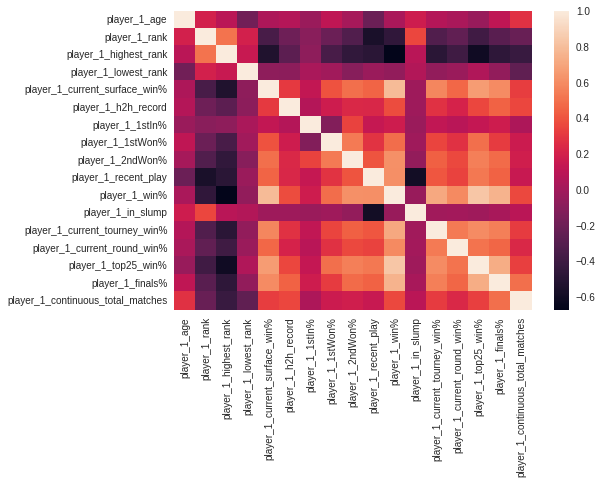

In [160]:
p1_list = matches[["player_1_age", "player_1_rank", "player_1_highest_rank", "player_1_lowest_rank", "player_1_current_surface_win%", "player_1_h2h_record", "player_1_1stIn%", 
                   "player_1_1stWon%", "player_1_2ndWon%", "player_1_recent_play", "player_1_win%", "player_1_in_slump", "player_1_current_tourney_win%",
                   "player_1_current_round_win%", "player_1_top25_win%", "player_1_finals%", "player_1_continuous_total_matches"]]

sns.heatmap(p1_list.corr());

### Converting Data

In [161]:
diff_list = ["age", "rank", "highest_rank", "lowest_rank", "current_surface_win%", "h2h_record", "1stIn%", "1stWon%", "2ndWon%", "recent_play", "win%", "in_slump", 
             "current_tourney_win%", "current_round_win%", "top25_win%", "finals%", "continuous_total_matches"]

for item in diff_list:

  matches[item + "_diff"] = matches.apply(lambda row: row["player_1_" + item] - row["player_2_" + item], axis=1)

matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump,player_1_current_tourney_win%,player_2_current_tourney_win%,player_1_current_round_win%,player_2_current_round_win%,player_1_top25_win%,player_2_top25_win%,player_1_finals%,player_2_finals%,player_1_highest_rank,player_2_highest_rank,player_1_lowest_rank,player_2_lowest_rank,player_1_continuous_total_matches,player_2_continuous_total_matches,age_diff,rank_diff,highest_rank_diff,lowest_rank_diff,current_surface_win%_diff,h2h_record_diff,1stIn%_diff,1stWon%_diff,2ndWon%_diff,recent_play_diff,win%_diff,in_slump_diff,current_tourney_win%_diff,current_round_win%_diff,top25_win%_diff,finals%_diff,continuous_total_matches_diff
0,2015-D009,Davis Cup WG QF: GBR vs FRA,Grass,4,D,2015-07-17,4,4-6 7-6 6-3 6-0,5,RR,NaN,Andy Murray,Gilles Simon,28.100000,30.500000,NaN,NaN,R,R,190.0,183.0,GBR,FRA,3.0,11.0,7810.0,2705.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Andy Murray,38,player_1,0.909091,0.750000,0.0,1.0,0.629301,0.573622,0.757467,0.695717,0.594661,0.566185,0.867925,0.720930,0.867925,0.704545,0,0,1.000000,0.500000,1.000000,0.500000,0.714286,0.428571,0.416667,0.066667,1.0,10.0,832.0,159.0,53.0,44.0,-2.400000,-8.0,-9.0,673.0,0.159091,-1.0,0.055679,0.061751,0.028477,0.146994,0.163379,0,0.500000,0.500000,0.285714,0.350000,9.0
1,2015-418,Washington,Hard,48,A,2015-08-03,47,4-6 6-4 6-4,3,F,NaN,John Isner,Kei Nishikori,30.200000,25.500000,NaN,NaN,R,R,206.0,178.0,USA,JPN,18.0,5.0,1890.0,5525.0,8.0,2.0,18.0,5.0,2.0,2.0,85.0,77.0,62.0,46.0,47.0,42.0,11.0,17.0,15.0,15.0,3.0,1.0,5.0,2.0,Kei Nishikori,30,player_2,0.650000,0.807692,1.0,0.0,0.707728,0.595888,0.810607,0.745994,0.635983,0.607121,0.625000,0.842105,0.627907,0.826087,0,0,0.600000,0.900000,1.000000,0.666667,0.428571,0.529412,0.062500,0.230769,9.0,4.0,39.0,69.0,43.0,46.0,4.700000,13.0,5.0,-30.0,-0.157692,1.0,0.111840,0.064614,0.028862,-0.217105,-0.198180,0,-0.300000,0.333333,-0.100840,-0.168269,-3.0
2,2015-421,Canada Masters,Hard,56,M,2015-08-10,39,6-3 3-6 7-6,3,R32,NaN,Gael Monfils,Gilles Muller,28.900000,32.200000,NaN,NaN,R,L,193.0,193.0,FRA,LUX,15.0,46.0,1975.0,945.0,15.0,NaN,11.0,10.0,3.0,2.0,98.0,79.0,64.0,49.0,48.0,44.0,19.0,17.0,15.0,15.0,9.0,0.0,10.0,1.0,Gilles Muller,31,player_2,0.750000,0.615385,0.0,0.0,0.650511,0.616803,0.735552,0.795761,0.589545,0.578404,0.757576,0.560000,0.731707,0.600000,0,0,0.777778,0.000000,0.750000,0.800000,0.500000,0.357143,0.071429,0.000000,6.0,21.0,46.0,127.0,41.0,40.0,-3.300000,-31.0,-15.0,-81.0,0.134615,0.0,0.033708,-0.060209,0.011141,0.197576,0.131707,0,0.777778,-0.050000,0.142857,0.071429,1.0
3,2015-421,Canada Masters,Hard,56,M,2015-08-10,46,6-4 6-4,3,R16,NaN,David Goffin,Kei Nishikori,24.600000,25.600000,NaN,NaN,R,R,180.0,178.0,BEL,JPN,14.0,4.0,2045.0,6025.0,13.0,4.0,6.0,10.0,4.0,1.0,66.0,61.0,33.0,37.0,27.0,32.0,14.0,12.0,10.0,10.0,3.0,2.0,5.0,2.0,Kei Nishikori,20,player_2,0.538462,0.838710,0.0,2.0,0.553547,0.595404,0.733272,0.754902,0.585582,0.610781,0.636364,0.846154,0.600000,0.843137,0,0,0.600000,0.714286,0.500000,0.916667,0.200000,0.578947,0.105263,0.285714,7.0,4.0,74

In [251]:
modeling_data = matches[["age_diff", "rank_diff", "highest_rank_diff", "lowest_rank_diff", "current_surface_win%_diff", "h2h_record_diff", "1stIn%_diff", "1stWon%_diff", 
                         "2ndWon%_diff", "recent_play_diff", "win%_diff", "in_slump_diff", "current_tourney_win%_diff", "current_round_win%_diff", "top25_win%_diff", 
                         "finals%_diff", "continuous_total_matches_diff", "target"]]
modeling_data

,age_diff,rank_diff,highest_rank_diff,lowest_rank_diff,current_surface_win%_diff,h2h_record_diff,1stIn%_diff,1stWon%_diff,2ndWon%_diff,recent_play_diff,win%_diff,in_slump_diff,current_tourney_win%_diff,current_round_win%_diff,top25_win%_diff,finals%_diff,continuous_total_matches_diff,target
0,-3.500000,-5.0,3.0,59.0,0.172043,0.0,-0.088648,0.030794,-0.005542,0.068376,0.078431,0,-0.007937,0.036364,-0.046053,0.019048,0.0,player_1
1,2.600000,-1.0,-3.0,763.0,-0.060932,1.0,0.033630,0.002422,-0.014094,0.023411,0.014006,0,0.168067,-0.041667,0.160183,0.071429,5.0,player_1
2,0.000000,2.0,0.0,810.0,-0.148148,-4.0,-0.037311,-0.005477,-0.053891,-0.081654,-0.084034,0,-0.117647,-0.150000,-0.180870,-0.442857,5.0,player_1
3,-5.800000,-1.0,0.0,5.0,-0.017199,1.0,0.020557,-0.052132,0.021624,0.084783,0.055288,0,0.152381,-0.025000,0.070402,0.166667,10.0,player_1
4,-3.700000,11.0,8.0,22.0,-0.242424,0.0,0.064332,0.003193,0.001509,-0.190426,-0.221236,0,-0.175000,-0.233333,-0.391667,-0.561404,2.0,player_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8845,11.058179,40.0,3.0,-638.0,-0.238095,-1.0,-0.023991,-0.026630,0.001141,-0.233266,-0.146238,0,-0.133117,-0.198291,-0.249524,-0.070015,159.0,player_1
8846,0.594114,11.0,5.0,32.0,0.069264,-1.0,-0.036865,0.051504,0.002213,0.000000,0.047760,0,0.050285,-0.045455,0.108278,-0.004710,-75.0,player_1
8847,1.897331,40.0,0.0,-263.0,0.063241,-2.0,-0.012399,-0.004890,-0.005980,0.056980,-0.020325,0,-0.053372,0.027273,-0.122488,0.095023,175.0,player_2
8848,4.462697,34.0,37.0,160.0,0.088235,-2.0,-0.005675,-0.038569,-0.043962,-0.270833,-0.156202,0,-0.116751,-0.280797,-0.383412,-0.433266,-195.0,player_2


In [252]:
modeling_data.isna().sum()

age_diff                         0
rank_diff                        0
highest_rank_diff                0
lowest_rank_diff                 0
current_surface_win%_diff        0
h2h_record_diff                  0
1stIn%_diff                      0
1stWon%_diff                     0
2ndWon%_diff                     0
recent_play_diff                 0
win%_diff                        0
in_slump_diff                    0
current_tourney_win%_diff        0
current_round_win%_diff          0
top25_win%_diff                  0
finals%_diff                     0
continuous_total_matches_diff    0
target                           0
dtype: int64

In [164]:
modeling_data.dropna(inplace=True)

In [165]:
mask = matches.loc[matches["rank_diff"].isna()]
mask

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump,player_1_current_tourney_win%,player_2_current_tourney_win%,player_1_current_round_win%,player_2_current_round_win%,player_1_top25_win%,player_2_top25_win%,player_1_finals%,player_2_finals%,player_1_highest_rank,player_2_highest_rank,player_1_lowest_rank,player_2_lowest_rank,player_1_continuous_total_matches,player_2_continuous_total_matches,age_diff,rank_diff,highest_rank_diff,lowest_rank_diff,current_surface_win%_diff,h2h_record_diff,1stIn%_diff,1stWon%_diff,2ndWon%_diff,recent_play_diff,win%_diff,in_slump_diff,current_tourney_win%_diff,current_round_win%_diff,top25_win%_diff,finals%_diff,continuous_total_matches_diff
4745,2019-0891,Pune,Hard,32,A,2018-12-31,298,7-6 4-6 6-3,3,SF,115.0,Ivo Karlovic,Steve Darcis,39.838467,34.800821,NaN,PR,R,R,208.0,178.0,CRO,BEL,100.0,NaN,589.0,NaN,NaN,NaN,33.0,3.0,4.0,2.0,89.0,95.0,58.0,80.0,52.0,57.0,17.0,8.0,16.0,15.0,1.0,5.0,2.0,6.0,Ivo Karlovic,32,player_1,0.532710,0.545455,0.0,0.0,0.652471,0.618846,0.831315,0.677195,0.659980,0.534026,0.333333,0.000000,0.533708,0.507463,1,1,0.594595,0.514286,0.416667,0.000000,0.411765,0.111111,0.139535,0.000000,18.0,38.0,221.0,321.0,178.0,67.0,5.037645,NaN,-20.0,-100.0,-0.012744,0.0,0.033625,0.154120,0.125954,0.333333,0.026245,0,0.080309,0.416667,0.300654,0.139535,111.0
4754,2019-0891,Pune,Hard,32,A,2018-12-31,295,7-5 6-2,3,QF,93.0,Malek Jaziri,Steve Darcis,34.945927,34.800821,NaN,PR,R,R,185.0,178.0,TUN,BEL,45.0,NaN,1014.0,NaN,4.0,NaN,6.0,1.0,0.0,0.0,56.0,65.0,22.0,42.0,17.0,27.0,14.0,16.0,10.0,10.0,1.0,3.0,5.0,4.0,Steve Darcis,20,player_2,0.435644,0.545455,0.0,1.0,0.531816,0.618846,0.717447,0.677195,0.534049,0.534026,0.375000,0.000000,0.426667,0.507463,0,1,0.428571,0.514286,0.300000,0.000000,0.161290,0.111111,0.022727,0.000000,43.0,38.0,329.0,321.0,150.0,67.0,0.145106,NaN,5.0,8.0,-0.109811,-1.0,-0.087029,0.040252,0.000023,0.375000,-0.080796,-1,-0.085714,0.300000,0.050179,0.022727,83.0
4762,2019-0891,Pune,Hard,32,A,2018-12-31,277,6-3 6-4,3,R32,93.0,Roberto Carballes Baena,Steve Darcis,25.774127,34.800821,NaN,PR,R,R,183.0,178.0,ESP,BEL,73.0,NaN,714.0,NaN,6.0,NaN,3.0,6.0,6.0,2.0,56.0,66.0,32.0,39.0,22.0,25.0,8.0,16.0,9.0,10.0,1.0,5.0,5.0,7.0,Steve Darcis,19,player_2,0.428571,0.545455,0.0,0.0,0.618647,0.618846,0.706426,0.677195,0.577840,0.534026,0.400000,0.000000,0.452830,0.507463,0,1,0.511111,0.514286,0.590909,0.600000,0.125000,0.111111,0.050000,0.000000,72.0,38.0,222.0,321.0,53.0,67.0,-9.026694,NaN,34.0,-99.0,-0.116883,0.0,-0.000199,0.029231,0.043814,0.400000,-0.054632,-1,-0.003175,-0.009091,0.013889,0.050000,-14.0
4853,2019-580,Australian Open,Hard,128,G,2019-01-14,152,4-6 6-3 6-1 6-4,5,R128,153.0,Grigor Dimitrov,Janko Tipsarevic,27.665982,34.562628,NaN,NaN,R,R,188.0,180.0,BUL,SRB,21.0,NaN,1790.0,NaN,20.0,NaN,18.0,6.0,8.0,4.0,112.0,121.0,69.0,70.0,59.0,48.0,18.0,22.0,18.0,18.0,3.0,10.0,4.0,15.0,Grigor Dimitrov,36,player_1,0.654545,0.411765,0.0,1.0,0.625130,0.542274,0.755695,0.728785,0.586478,0.535846,0.500000,0.000000,0.621739,0.357143,0,1,0.644444,0.222222,0.750000,0.285714,0.425000,0.000000,0.250000,0.000000,3.0

In [167]:
matches.drop(mask.index, inplace=True)

In [169]:
matches.reset_index(drop=True, inplace=True)
matches

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,score,best_of,round,minutes,player_1,player_2,player_1_age,player_2_age,player_1_entry,player_2_entry,player_1_hand,player_2_hand,player_1_ht,player_2_ht,player_1_ioc,player_2_ioc,player_1_rank,player_2_rank,player_1_rank_points,player_2_rank_points,player_1_seed,player_2_seed,player_1_ace,player_2_ace,player_1_df,player_2_df,player_1_svpt,player_2_svpt,player_1_1stIn,player_2_1stIn,player_1_1stWon,player_2_1stWon,player_1_2ndWon,player_2_2ndWon,player_1_SvGms,player_2_SvGms,player_1_bpSaved,player_2_bpSaved,player_1_bpFaced,player_2_bpFaced,winner,total_games,target,player_1_current_surface_win%,player_2_current_surface_win%,player_1_h2h_record,player_2_h2h_record,player_1_1stIn%,player_2_1stIn%,player_1_1stWon%,player_2_1stWon%,player_1_2ndWon%,player_2_2ndWon%,player_1_recent_play,player_2_recent_play,player_1_win%,player_2_win%,player_1_in_slump,player_2_in_slump,player_1_current_tourney_win%,player_2_current_tourney_win%,player_1_current_round_win%,player_2_current_round_win%,player_1_top25_win%,player_2_top25_win%,player_1_finals%,player_2_finals%,player_1_highest_rank,player_2_highest_rank,player_1_lowest_rank,player_2_lowest_rank,player_1_continuous_total_matches,player_2_continuous_total_matches,age_diff,rank_diff,highest_rank_diff,lowest_rank_diff,current_surface_win%_diff,h2h_record_diff,1stIn%_diff,1stWon%_diff,2ndWon%_diff,recent_play_diff,win%_diff,in_slump_diff,current_tourney_win%_diff,current_round_win%_diff,top25_win%_diff,finals%_diff,continuous_total_matches_diff
0,2015-D009,Davis Cup WG QF: GBR vs FRA,Grass,4,D,2015-07-17,4,4-6 7-6 6-3 6-0,5,RR,NaN,Andy Murray,Gilles Simon,28.100000,30.500000,NaN,NaN,R,R,190.0,183.0,GBR,FRA,3.0,11.0,7810.0,2705.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Andy Murray,38,player_1,0.909091,0.750000,0.0,1.0,0.629301,0.573622,0.757467,0.695717,0.594661,0.566185,0.867925,0.720930,0.867925,0.704545,0,0,1.000000,0.500000,1.000000,0.500000,0.714286,0.428571,0.416667,0.066667,1.0,10.0,832.0,159.0,53.0,44.0,-2.400000,-8.0,-9.0,673.0,0.159091,-1.0,0.055679,0.061751,0.028477,0.146994,0.163379,0,0.500000,0.500000,0.285714,0.350000,9.0
1,2015-418,Washington,Hard,48,A,2015-08-03,47,4-6 6-4 6-4,3,F,NaN,John Isner,Kei Nishikori,30.200000,25.500000,NaN,NaN,R,R,206.0,178.0,USA,JPN,18.0,5.0,1890.0,5525.0,8.0,2.0,18.0,5.0,2.0,2.0,85.0,77.0,62.0,46.0,47.0,42.0,11.0,17.0,15.0,15.0,3.0,1.0,5.0,2.0,Kei Nishikori,30,player_2,0.650000,0.807692,1.0,0.0,0.707728,0.595888,0.810607,0.745994,0.635983,0.607121,0.625000,0.842105,0.627907,0.826087,0,0,0.600000,0.900000,1.000000,0.666667,0.428571,0.529412,0.062500,0.230769,9.0,4.0,39.0,69.0,43.0,46.0,4.700000,13.0,5.0,-30.0,-0.157692,1.0,0.111840,0.064614,0.028862,-0.217105,-0.198180,0,-0.300000,0.333333,-0.100840,-0.168269,-3.0
2,2015-421,Canada Masters,Hard,56,M,2015-08-10,39,6-3 3-6 7-6,3,R32,NaN,Gael Monfils,Gilles Muller,28.900000,32.200000,NaN,NaN,R,L,193.0,193.0,FRA,LUX,15.0,46.0,1975.0,945.0,15.0,NaN,11.0,10.0,3.0,2.0,98.0,79.0,64.0,49.0,48.0,44.0,19.0,17.0,15.0,15.0,9.0,0.0,10.0,1.0,Gilles Muller,31,player_2,0.750000,0.615385,0.0,0.0,0.650511,0.616803,0.735552,0.795761,0.589545,0.578404,0.757576,0.560000,0.731707,0.600000,0,0,0.777778,0.000000,0.750000,0.800000,0.500000,0.357143,0.071429,0.000000,6.0,21.0,46.0,127.0,41.0,40.0,-3.300000,-31.0,-15.0,-81.0,0.134615,0.0,0.033708,-0.060209,0.011141,0.197576,0.131707,0,0.777778,-0.050000,0.142857,0.071429,1.0
3,2015-421,Canada Masters,Hard,56,M,2015-08-10,46,6-4 6-4,3,R16,NaN,David Goffin,Kei Nishikori,24.600000,25.600000,NaN,NaN,R,R,180.0,178.0,BEL,JPN,14.0,4.0,2045.0,6025.0,13.0,4.0,6.0,10.0,4.0,1.0,66.0,61.0,33.0,37.0,27.0,32.0,14.0,12.0,10.0,10.0,3.0,2.0,5.0,2.0,Kei Nishikori,20,player_2,0.538462,0.838710,0.0,2.0,0.553547,0.595404,0.733272,0.754902,0.585582,0.610781,0.636364,0.846154,0.600000,0.843137,0,0,0.600000,0.714286,0.500000,0.916667,0.200000,0.578947,0.105263,0.285714,7.0,4.0,74

## Modeling

### PyCaret

In [331]:
matches2 = modeling_data[['age_diff', 'rank_diff', 'highest_rank_diff', 'current_surface_win%_diff', 'recent_play_diff', 'win%_diff',
                          'target']]

In [285]:
matches2.iloc[:,0:-1] = matches2.iloc[:,0:-1].apply(lambda x: (x - x.mean()) / x.std(), axis=0)
matches2

,age_diff,rank_diff,highest_rank_diff,current_surface_win%_diff,recent_play_diff,win%_diff,target
0,-0.409703,-0.014342,0.236417,0.924928,0.271878,0.547246,player_1
1,0.582457,0.045523,-0.024212,-0.268712,0.082060,0.127831,player_1
2,0.159569,0.090421,0.106102,-0.715562,-0.361473,-0.510409,player_1
3,-0.783797,0.045523,0.106102,-0.044648,0.341138,0.396580,player_1
4,-0.442233,0.225117,0.453608,-1.198583,-0.820649,-1.403601,player_2
...,...,...,...,...,...,...,...
8845,1.958173,0.659138,0.236417,-1.176403,-1.001498,-0.915359,player_1
8846,0.256201,0.225117,0.323293,0.398343,-0.016771,0.347574,player_1
8847,0.468168,0.659138,0.106102,0.367484,0.223770,-0.095664,player_2
8848,0.885423,0.569341,1.713315,0.495541,-1.160089,-0.980226,player_2


In [286]:
s = setup(data=matches2, target='target', session_id=42)

,Description,Value
0,session_id,42
1,Target,target
2,Target Type,Binary
3,Label Encoded,"player_1: 0, player_2: 1"
4,Original Data,"(8850, 7)"
5,Missing Values,False
6,Numeric Features,6
7,Categorical Features,0
8,Ordinal Features,False
9,High Cardinality Features,False


INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[], target='target',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_strat...
                ('scaling', 'passthrough'), ('P_transform', 'passthrough'),
                ('binn', 'passthrough'), ('rem_outliers', 'passthrough'),
                ('cluste

In [287]:
data = matches2.sample(frac=0.9, random_state=786)
data_unseen = matches2.drop(data.index)

data.reset_index(drop=True, inplace=True)
data_unseen.reset_index(drop=True, inplace=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (7965, 7)
Unseen Data For Predictions: (885, 7)


In [288]:
data_unseen

,age_diff,rank_diff,highest_rank_diff,current_surface_win%_diff,recent_play_diff,win%_diff,target
0,-0.442233,0.225117,0.453608,-1.198583,-0.820649,-1.403601,player_2
1,-0.003080,-0.104140,-0.067651,0.755063,0.986071,1.388741,player_2
2,-0.718737,0.344847,0.801113,-1.002136,-1.711483,-1.915891,player_2
3,0.436073,-0.074207,-0.415156,0.035743,0.288114,0.337174,player_1
4,-0.637412,0.120354,0.106102,-0.853137,-0.395442,-0.606772,player_2
...,...,...,...,...,...,...,...
880,0.600425,0.284982,0.366731,-1.554171,-0.702077,-0.078807,player_2
881,1.142812,0.165252,-0.806100,-0.810441,0.345071,0.159107,player_2
882,-0.197569,-0.553126,-0.892976,1.049866,1.235189,0.977433,player_2
883,0.143538,0.210151,0.714237,-2.091309,-1.136382,-1.199751,player_2


In [289]:
best = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
gbc,Gradient Boosting Classifier,0.6736,0.7290,0.6429,0.6825,0.6620,0.3469,0.3476,0.818
ada,Ada Boost Classifier,0.6705,0.7240,0.6224,0.6862,0.6524,0.3406,0.3423,0.271
ridge,Ridge Classifier,0.6698,0.0000,0.6565,0.6722,0.6641,0.3396,0.3399,0.021
lr,Logistic Regression,0.6697,0.7316,0.6555,0.6723,0.6636,0.3393,0.3395,0.030
lda,Linear Discriminant Analysis,0.6697,0.7317,0.6562,0.6721,0.6638,0.3393,0.3395,0.022
svm,SVM - Linear Kernel,0.6690,0.0000,0.6338,0.6799,0.6550,0.3378,0.3395,0.034
nb,Naive Bayes,0.6674,0.7260,0.6406,0.6744,0.6569,0.3346,0.3352,0.017
lightgbm,Light Gradient Boosting Machine,0.6653,0.7152,0.6432,0.6706,0.6564,0.3305,0.3309,0.125
qda,Quadratic Discriminant Analysis,0.6637,0.7209,0.6656,0.6609,0.6629,0.3274,0.3277,0.018
rf,Random Forest Classifier,0.6509,0.7083,0.6224,0.6576,0.6393,0.3017,0.3023,1.216


INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=42, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:compare_models() succesfully completed......................................


In [311]:
rf = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.6613,0.7133,0.6461,0.6633,0.6546,0.3224,0.3225
1,0.6613,0.7096,0.6461,0.6633,0.6546,0.3224,0.3225
2,0.6677,0.7228,0.6266,0.6796,0.6520,0.3351,0.3361
3,0.6419,0.6970,0.6104,0.6483,0.6288,0.2836,0.2841
4,0.6527,0.7087,0.6071,0.6655,0.6350,0.3050,0.3062
5,0.6559,0.7211,0.6071,0.6703,0.6371,0.3115,0.3128
6,0.6543,0.7111,0.6526,0.6526,0.6526,0.3085,0.3085
7,0.6543,0.7063,0.6169,0.6643,0.6397,0.3083,0.3091
8,0.6300,0.6919,0.6201,0.6304,0.6252,0.2600,0.2601


INFO:logs:create_model_container: 33
INFO:logs:master_model_container: 33
INFO:logs:display_container: 21
INFO:logs:RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=42, verbose=0,
                       warm_start=False)
INFO:logs:create_model() succesfully completed......................................


In [312]:
tuned_rf = tune_model(rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.6677,0.7393,0.6364,0.6759,0.6555,0.3352,0.3358
1,0.6581,0.7306,0.6494,0.6579,0.6536,0.3160,0.3161
2,0.6887,0.7362,0.6688,0.6936,0.6810,0.3773,0.3775
3,0.6548,0.7141,0.6299,0.6599,0.6445,0.3094,0.3098
4,0.6737,0.7349,0.6364,0.6853,0.6599,0.3471,0.3480
5,0.6817,0.7381,0.6591,0.6881,0.6733,0.3633,0.3637
6,0.6931,0.7412,0.6753,0.6980,0.6865,0.3860,0.3862
7,0.6834,0.7287,0.6656,0.6879,0.6766,0.3666,0.3668
8,0.6624,0.7213,0.6494,0.6645,0.6568,0.3246,0.3247


INFO:logs:create_model_container: 34
INFO:logs:master_model_container: 34
INFO:logs:display_container: 22
INFO:logs:RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={},
                       criterion='gini', max_depth=9, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0, min_impurity_split=None,
                       min_samples_leaf=6, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=120,
                       n_jobs=-1, oob_score=False, random_state=42, verbose=0,
                       warm_start=False)
INFO:logs:tune_model() succesfully completed......................................


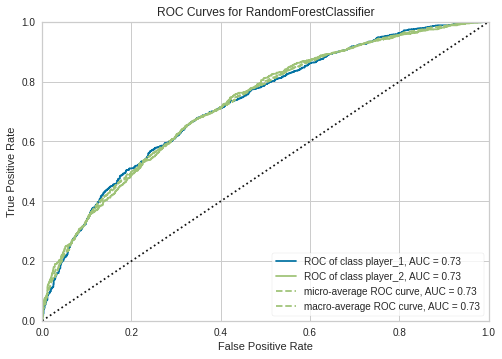

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [313]:
plot_model(tuned_rf)

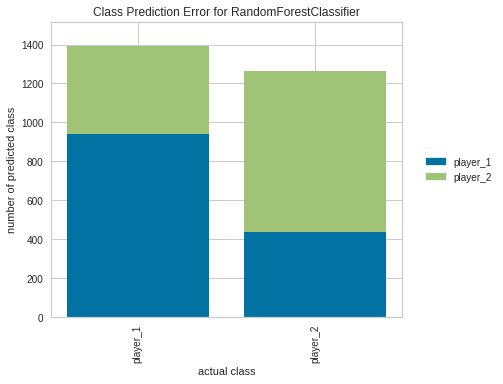

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [314]:
plot_model(tuned_rf, plot = 'error')

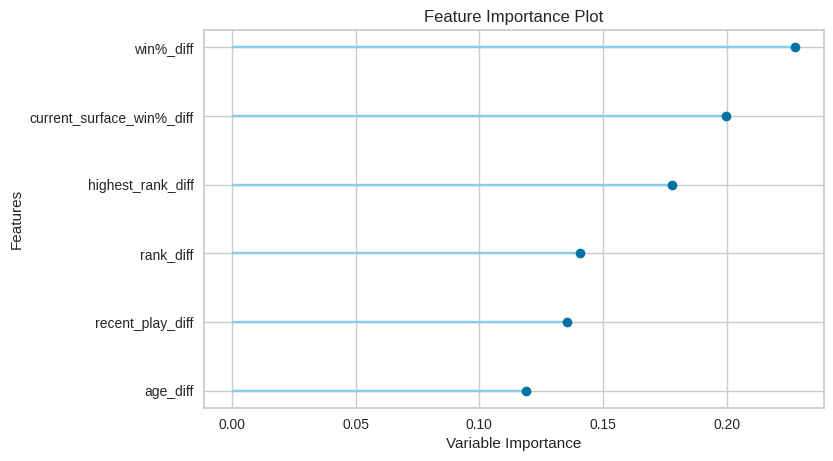

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [315]:
plot_model(tuned_rf, plot = 'feature')

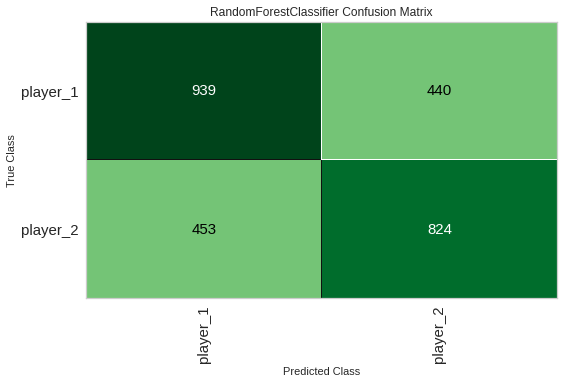

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [316]:
plot_model(tuned_rf, plot = 'confusion_matrix')

In [317]:
evaluate_model(tuned_rf)

INFO:logs:Initializing evaluate_model()
INFO:logs:evaluate_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={},
                       criterion='gini', max_depth=9, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0, min_impurity_split=None,
                       min_samples_leaf=6, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=120,
                       n_jobs=-1, oob_score=False, random_state=42, verbose=0,
                       warm_start=False), fold=None, fit_kwargs=None, plot_kwargs=None, feature_name=None, groups=None, use_train_data=False)


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [318]:
predict_model(tuned_rf)

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={},
                       criterion='gini', max_depth=9, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0, min_impurity_split=None,
                       min_samples_leaf=6, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=120,
                       n_jobs=-1, oob_score=False, random_state=42, verbose=0,
                       warm_start=False), probability_threshold=None, encoded_labels=False, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.6638,0.726,0.6453,0.6519,0.6486,0.3263,0.3263


,age_diff,rank_diff,highest_rank_diff,current_surface_win%_diff,recent_play_diff,win%_diff,target,Label,Score
0,-0.100670,-0.538160,-1.110167,1.205400,-0.277509,0.967259,player_1,player_1,0.7398
1,-1.162554,-0.717755,-1.587987,0.631393,0.247072,0.723277,player_1,player_1,0.8059
2,-2.721137,-1.091910,-0.154527,0.004909,0.809172,0.105257,player_2,player_1,0.7112
3,0.755838,-0.373532,-1.587987,1.324338,-0.383856,0.894568,player_1,player_1,0.6779
4,2.037438,0.868665,1.105181,-0.863555,-1.191169,-0.560364,player_1,player_2,0.7367
...,...,...,...,...,...,...,...,...,...
2651,1.900283,0.150286,-0.806100,1.135047,0.341918,1.253599,player_2,player_1,0.6396
2652,-1.775745,0.449611,0.497046,-1.717153,-1.468503,-2.235287,player_2,player_2,0.9421
2653,-0.651339,-0.134072,-0.588909,0.393366,0.735421,1.090624,player_1,player_1,0.7449
2654,-0.039930,-0.029308,-0.806100,-0.069547,-0.921374,-0.496979,player_1,player_2,0.5236


In [319]:
final_rf = finalize_model(tuned_rf)

INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={},
                       criterion='gini', max_depth=9, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0, min_impurity_split=None,
                       min_samples_leaf=6, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=120,
                       n_jobs=-1, oob_score=False, random_state=42, verbose=0,
                       warm_start=False), fit_kwargs=None, groups=None, model_only=True, display=None, experiment_custom_tags=None, return_train_score=False)
INFO:logs:Finalizing RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={},
                       criterion='gini', max_depth=9, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decreas

In [320]:
type(final_rf)

sklearn.ensemble._forest.RandomForestClassifier

In [321]:
print(final_rf)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={},
                       criterion='gini', max_depth=9, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0, min_impurity_split=None,
                       min_samples_leaf=6, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=120,
                       n_jobs=-1, oob_score=False, random_state=42, verbose=0,
                       warm_start=False)


In [322]:
preds = predict_model(final_rf)

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={},
                       criterion='gini', max_depth=9, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0, min_impurity_split=None,
                       min_samples_leaf=6, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=120,
                       n_jobs=-1, oob_score=False, random_state=42, verbose=0,
                       warm_start=False), probability_threshold=None, encoded_labels=False, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.7515,0.8363,0.7251,0.7498,0.7373,0.5017,0.5019


In [323]:
preds

,age_diff,rank_diff,highest_rank_diff,current_surface_win%_diff,recent_play_diff,win%_diff,target,Label,Score
0,-0.100670,-0.538160,-1.110167,1.205400,-0.277509,0.967259,player_1,player_1,0.7703
1,-1.162554,-0.717755,-1.587987,0.631393,0.247072,0.723277,player_1,player_1,0.8098
2,-2.721137,-1.091910,-0.154527,0.004909,0.809172,0.105257,player_2,player_1,0.6723
3,0.755838,-0.373532,-1.587987,1.324338,-0.383856,0.894568,player_1,player_1,0.7082
4,2.037438,0.868665,1.105181,-0.863555,-1.191169,-0.560364,player_1,player_2,0.6813
...,...,...,...,...,...,...,...,...,...
2651,1.900283,0.150286,-0.806100,1.135047,0.341918,1.253599,player_2,player_2,0.5590
2652,-1.775745,0.449611,0.497046,-1.717153,-1.468503,-2.235287,player_2,player_2,0.9353
2653,-0.651339,-0.134072,-0.588909,0.393366,0.735421,1.090624,player_1,player_1,0.7691
2654,-0.039930,-0.029308,-0.806100,-0.069547,-0.921374,-0.496979,player_1,player_1,0.5856


In [324]:
unseen_predictions = predict_model(final_rf, data=data_unseen)

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={},
                       criterion='gini', max_depth=9, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0, min_impurity_split=None,
                       min_samples_leaf=6, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=120,
                       n_jobs=-1, oob_score=False, random_state=42, verbose=0,
                       warm_start=False), probability_threshold=None, encoded_labels=False, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0,0.815,0,0,0,0,0


In [325]:
check_metric(unseen_predictions.target, unseen_predictions.Label, 'Accuracy')

0.7435

### Neural Network

In [358]:
X, y = matches2.drop("target", axis=1), matches2["target"]

print(y[:5])
y = LabelEncoder().fit_transform(y)
print(y[:5])

0    player_1
1    player_1
2    player_1
3    player_1
4    player_2
Name: target, dtype: object
[0 0 0 0 1]


In [359]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print(X_train.shape, y_train.shape, X_test.shape, y_test.shape)

(7080, 6) (7080,) (1770, 6) (1770,)


In [360]:
n_features = X_train.shape[1]

model = Sequential()
model.add(Dense(10, activation='relu', kernel_initializer='he_normal', input_shape=(n_features,)))
model.add(Dense(8, activation='relu', kernel_initializer='he_normal'))
model.add(Dense(1, activation='sigmoid'))

In [361]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 10)                70        
                                                                 
 dense_1 (Dense)             (None, 8)                 88        
                                                                 
 dense_2 (Dense)             (None, 1)                 9         
                                                                 
Total params: 167
Trainable params: 167
Non-trainable params: 0
_________________________________________________________________


In [363]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=150, batch_size=32)
loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
print('Test Accuracy = %.3f' %accuracy)

Epoch 1/150
222/222 [==============================] - 2s 3ms/step - loss: 1.7525 - accuracy: 0.6234
Epoch 2/150
222/222 [==============================] - 1s 2ms/step - loss: 0.7592 - accuracy: 0.6213
Epoch 3/150
222/222 [==============================] - 1s 2ms/step - loss: 0.6938 - accuracy: 0.6260
Epoch 4/150
222/222 [==============================] - 1s 2ms/step - loss: 0.6711 - accuracy: 0.6346
Epoch 5/150
222/222 [==============================] - 1s 3ms/step - loss: 0.6588 - accuracy: 0.6465
Epoch 6/150
222/222 [==============================] - 1s 3ms/step - loss: 0.6595 - accuracy: 0.6418
Epoch 7/150
222/222 [==============================] - 1s 2ms/step - loss: 0.6460 - accuracy: 0.6424
Epoch 8/150
222/222 [==============================] - 0s 2ms/step - loss: 0.6502 - accuracy: 0.6449
Epoch 9/150
222/222 [==============================] - 1s 6ms/step - loss: 0.6412 - accuracy: 0.6494
Epoch 10/150
222/222 [==============================] - 1s 4ms/step - loss: 0.6400 - accura

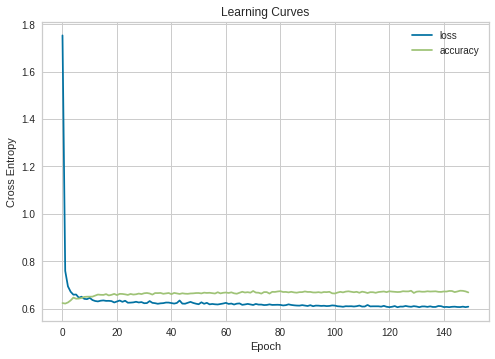

In [364]:
plt.title('Learning Curves')
plt.xlabel('Epoch')
plt.ylabel('Cross Entropy')
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['accuracy'], label='accuracy')
plt.legend()
plt.show()

In [365]:
matches2.columns

Index(['age_diff', 'rank_diff', 'highest_rank_diff',
       'current_surface_win%_diff', 'recent_play_diff', 'win%_diff', 'target'],
      dtype='object')

## Results

Using PyCaret, I ended up using a RandomForestClassifier estimator with only some of the original features I created:
* age
* rank
* highest_rank
* current_surface_win%
* recent_play
* win%
The model predicted with a ~75% accuracy on a test dataset.

With the neural network, I didn't get as high results with a 67% accuracy.